# Nightvision

Satellite instruments take images across a borad range of wavelengths. Among these, observations in the visible and near-infrared regions of reflected sunlight are vital for measurements of surface and atmospheric properties. However, these observations are only available during the daytime, while observations in the thermal IR wavelengths are available uniformly throughout the day and night. In this challenge, the aim is to take infrared images taken from a satellite at all times of day and night, and predict the visible image corresponding to the IR observations.

---

### Overview

The second generation Meteosat satellites are used to observe the Earth from a geostationary orbit for improving weather forecasts. The SEVIRI instrument makes observations across a range of channels in the visible, near-IR and thermal IR. Visible and near-IR channels can be combined to create a "natural colour" image as shown below. Note that ice clouds appear Cyan due to the use of the 1.6 micron wavelength observations in the place of red light.

<img src=media/seviri_europe_natural_color.png alt="SEVIRI visible (natural colour) image" width=800>

The thermal IR channels can also be combined to create a false colour "cloudtop" composite, like that shown below. Unlike the natural colour composite, this provides imagery during both day and night.

<img src=media/seviri_europe_cloudtop.png alt="SEVIRI IR (cloudtop) image" width=800>

### Objectives

The purpose of this challenge is to develop an algorithm to translate IR images taken at nighttime into visible images seen as if it were daytime. To do this, we will train an ML model to extract the information about visible properties that is hidden in IR channels.

To carry out this image-to-image translation task, we will implement a model using the UNet architecture \[Ronneberger et al., 2015]. UNets are a form of convolutional neural nets that are commonly used for image tranlsation and segmentation tasks. As well as being used on their own, UNet components are also often used in diffusion models and generative adversarial networks.

As part of this computing lab, you will:

  1. Read and visualise RGB composites from visible and infra-red satellite observations
  2. Produce an ML ready dataset of paired satellite images
  3. Develop a simple baseline model and analyse its predictions
  4. Compare different metrics for teesting image to image translation
  5. Train a UNet model to perform image to image translation
  6. Improve this UNet model, by experimenting with different loss functions, layers and improved architectures

---

This challenge is based on the challenge of the same name from the Climate Informatics 2020 hackathon \[Jones and Lguensat, 2021] and the solutions presented in Harder et al. \[2020]

#### References

Harder, P. et al. NightVision: Generating Nighttime Satellite Imagery from Infra-Red Observations. Preprint at https://doi.org/10.48550/arXiv.2011.07017 (2020).

Jones, W. K., Lguensat, R., Charantonis, A. & Watson-Parris, D. The 2020 Climate Informatics Hackathon: Generating Nighttime Satellite Imagery from Infrared Observations. in Proceedings of the 10th International Conference on Climate Informatics 134–138 (Association for Computing Machinery, New York, NY, USA, 2021). doi:10.1145/3429309.3429329.

Ronneberger, O., Fischer, P. & Brox, T. U-Net: Convolutional Networks for Biomedical Image Segmentation. Preprint at https://doi.org/10.48550/arXiv.1505.04597 (2015).

Zhang, Z., Liu, Q. & Wang, Y. Road Extraction by Deep Residual U-Net. Preprint at https://doi.org/10.48550/arXiv.1711.10684 (2017).

Zhou, Z., Siddiquee, M. M. R., Tajbakhsh, N. & Liang, J. UNet++: A Nested U-Net Architecture for Medical Image Segmentation. Preprint at https://doi.org/10.48550/arXiv.1807.10165 (2018).


In [1]:
import pathlib
import tempfile
import urllib
import zipfile

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

## 1. Download and read data

The training data for this task consists of paired visible and IR images from SEVIRI. Each image is 128x128 pixels.

First, we need to locate and download the data from the Zenodo repository if it is not already present. This will require 500MB of storage, and takes about a minute

In [2]:
data_path = pathlib.Path("/work/scratch-nopw2/iecdt_ai4eo/data/2-nightvision")
if data_path.exists():
    print("Storing data on JASMIN")
else:
    data_path = pathlib.Path("../../data/2-nightvision")
    print("Storing data locally")
    if not data_path.exists():
        data_path.mkdir()

Storing data locally


In [3]:
cloudtop_path = data_path / "cloudtop_patches"
if not cloudtop_path.exists():
    with tempfile.NamedTemporaryFile() as tmp:
        print("Downloading https://zenodo.org/records/14203536/files/cloudtop_patches.zip")
        urllib.request.urlretrieve(
            "https://zenodo.org/records/14203536/files/cloudtop_patches.zip", tmp.name
        )
        print("Extracting cloudtop_patches.zip")
        with zipfile.ZipFile(tmp, 'r') as zip_ref:
            zip_ref.extractall(data_path)

    assert cloudtop_path.exists(), "Download failed!"

In [4]:
natural_colour_path = data_path / "natural_colour_patches"
if not natural_colour_path.exists():
    with tempfile.NamedTemporaryFile() as tmp:
        print("Downloading https://zenodo.org/records/14203536/files/natural_colour_patches.zip")
        urllib.request.urlretrieve(
            "https://zenodo.org/records/14203536/files/natural_colour_patches.zip", tmp.name
        )
        print("Extracting natural_colour_patches.zip")
        with zipfile.ZipFile(tmp, 'r') as zip_ref:
            zip_ref.extractall(data_path)

    assert natural_colour_path.exists(), "Download failed!"

In [5]:
metadata_file = data_path / "metadata.csv"
if not metadata_file.exists():
    print("Downloading https://zenodo.org/records/14203536/files/metadata.csv")
    urllib.request.urlretrieve(
        "https://zenodo.org/records/14203536/files/metadata.csv", metadata_file
    )
    assert metadata_file.exists(), "Download failed!"

Now we can search for the individual files, there should be 8760 of each:

In [6]:
cloudtop_files = sorted(list(cloudtop_path.glob("cloudtop_*.png")))
natural_colour_files = sorted(list(natural_colour_path.glob("natural_colour_*.png")))

In [7]:
print(f'Cloudtop files: {len(cloudtop_files)}, Natural colour files: {len(natural_colour_files)}')

Cloudtop files: 8760, Natural colour files: 8760


Each file is a png image that we can read using `plt.imread` to produce a RGBA array with values between 0 and 1:

In [8]:
cloudtop_image = plt.imread(cloudtop_files[0])
natural_colour_image = plt.imread(natural_colour_files[0])

In [9]:
print(f'Image shape: {natural_colour_image.shape}, min: {natural_colour_image.min()}, max: {natural_colour_image.max()}')

Image shape: (128, 128, 4), min: 0.0, max: 1.0


Now lets visualise a selection of the images:

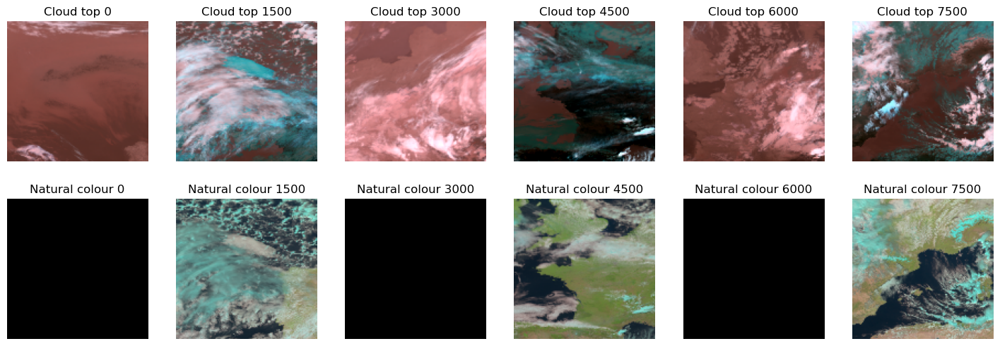

In [10]:
fig, axes = plt.subplots(2, 6, figsize=(18,6))

stride = 1500

for i in range(6):
    cloudtop_image = plt.imread(cloudtop_files[i*stride])
    natural_colour_image = plt.imread(natural_colour_files[i*stride])
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(natural_colour_image)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'Natural colour {i*stride}')

As you can see, some of the natural colour images are completely blank. The dataset contains image pairs from all times of day, including at night. To train a model, we need to select only the images where we have a valid target (visible image).

## 2. Data cleaning

The first step in the processing pipeline is to clean the incoming data to ensure we have a good training dataset. A simple approach to removing the nighttime images is to remove image pairs where all of the visible pixels are zero:

In [11]:
# First, load all images into a stack and remove the alpha channel:
natural_colour = np.stack([plt.imread(f)[...,:-1] for f in natural_colour_files])

In [12]:
is_nighttime = np.all(
    natural_colour==0, axis=(1,2,3)
)

print(f'Total nighttime images: {is_nighttime.sum()}')

Total nighttime images: 3467


In [13]:
# Now crop the natural_colour and cloudtop arrays using the nighttime image array:
from itertools import compress

natural_colour_daytime_files = list(compress(natural_colour_files, np.logical_not(is_nighttime)))
cloudtop_daytime_files = list(compress(cloudtop_files, np.logical_not(is_nighttime)))

print(len(natural_colour_daytime_files), len(cloudtop_daytime_files))

5293 5293


Now let's visualise the results:

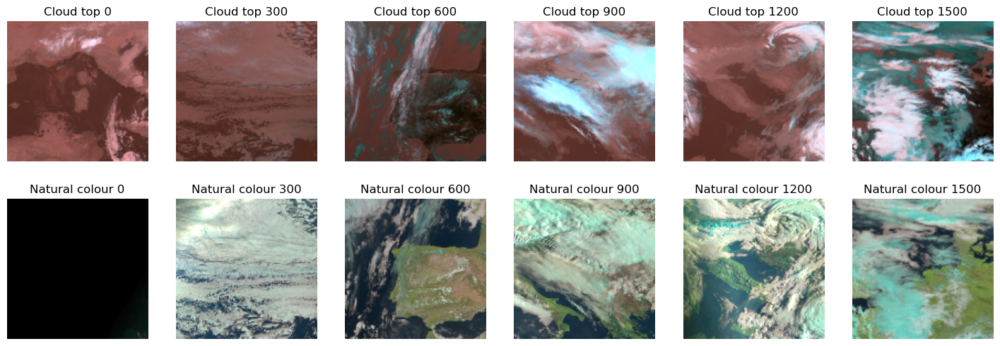

In [14]:
fig, axes = plt.subplots(2, 6, figsize=(18,6))

stride = 300

for i in range(6):
    cloudtop_image = plt.imread(cloudtop_daytime_files[i*stride])
    natural_colour_image = plt.imread(natural_colour_daytime_files[i*stride])
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(natural_colour_image)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'Natural colour {i*stride}')

While this has increased the proportion of daytime images, there are still some image pairs where the visible image is mostly darkness, and some where the edge of the image is becoming darker. Now it's your turn to improve the data cleaning to ensure that we have a good quality dataset for model training while maintaining the size of the dataset as much as possible

## Exercises:
1. Plot histograms of the red, green and blue channels for the natural_colour images. What might be a good cutoff values for pixels to be considered in darkness?
2. Rather than requiring all pixels to be in darkness to be considered nighttime, a better threshold might be if more than 50% of pixels are dark. Implement this requirement to create a new nighttime mask.
3. Experiment with different pixel values that are considered dark, and different percentage of the image to be considered dark. How do different choices affect the number of image pairs remaining in the training dataset? What do you think will be the best compromise?
4. Apply your chosen best thresholds to filter the daytime images and plot the results
5. Open the file `metadata.csv` using pandas. Append your nighttime flag as a new column to the dataframe 

Extension questions:

6. What other data cleaning approaches might be useful for removing night time images?
<details>
    <summary>Hints:</summary>
    - The `pysolar` library can be used to calculate the solar zenith angle (the angle in degree of the sun from vertical) using the latitude, longitude and time of day of a place. Use the information in the `metadata.csv` file to calculate the soalr zenith angle of each image pair and use this to filter the nighttime images instead of the pixel values
</details>

8. What other data quality issues might be present in earth observation images? How might you address these?

### Exercise answers:

Text(0.5, 1.0, 'Natural colour histogram by channel')

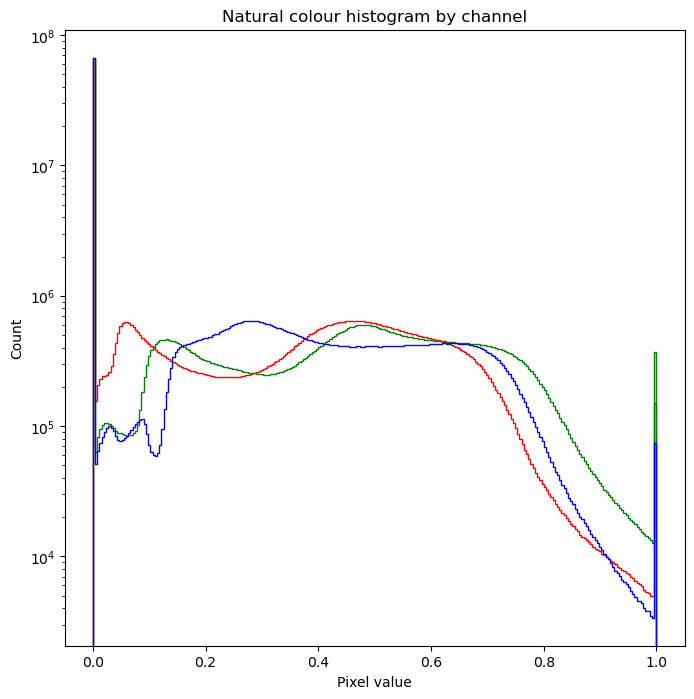

In [15]:
# 1. Plotting histograms:

fig, ax = plt.subplots(figsize=(8,8))

h_red= ax.hist(natural_colour[...,0].ravel(), bins=np.linspace(0, 1, 256), color="red", histtype="step")
h_green = ax.hist(natural_colour[...,1].ravel(), bins=np.linspace(0, 1, 256), color="green", histtype="step")
h_blue = ax.hist(natural_colour[...,2].ravel(), bins=np.linspace(0, 1, 256), color="blue", histtype="step")

ax.set_yscale("log")
ax.set_xlabel("Pixel value")
ax.set_ylabel("Count")
ax.set_title("Natural colour histogram by channel")

Between 0.05 and 0.1 seems like a good value

In [16]:
# 2: mask by proportion:
is_50percent_nighttime = np.mean(
    natural_colour==0, axis=(1,2,3)
) > 0.5
print(f'Total nighttime images: {is_50percent_nighttime.sum()}')

Total nighttime images: 4067


In [17]:
# 3: Now lets span a range of values for each
for percentage in [1, 25, 50, 75, 99]:
    for threshold in [0, 0.05, 0.1, 0.2]:
        print(f'Threshold={threshold}, percentage={percentage}%, removed images={
            (np.mean(
                natural_colour<=threshold, axis=(1,2,3)
            ) > (percentage/100)).sum()
        }')

Threshold=0, percentage=1%, removed images=4552
Threshold=0.05, percentage=1%, removed images=5310
Threshold=0.1, percentage=1%, removed images=7290
Threshold=0.2, percentage=1%, removed images=8434
Threshold=0, percentage=25%, removed images=4240
Threshold=0.05, percentage=25%, removed images=4324
Threshold=0.1, percentage=25%, removed images=4432
Threshold=0.2, percentage=25%, removed images=5313
Threshold=0, percentage=50%, removed images=4067
Threshold=0.05, percentage=50%, removed images=4151
Threshold=0.1, percentage=50%, removed images=4236
Threshold=0.2, percentage=50%, removed images=4434
Threshold=0, percentage=75%, removed images=3870
Threshold=0.05, percentage=75%, removed images=3980
Threshold=0.1, percentage=75%, removed images=4066
Threshold=0.2, percentage=75%, removed images=4171
Threshold=0, percentage=99%, removed images=3558
Threshold=0.05, percentage=99%, removed images=3672
Threshold=0.1, percentage=99%, removed images=3764
Threshold=0.2, percentage=99%, removed i

Looks like the threshold value matters much less than the percentage of the image. At 1% dark pixels almost all of the dataset is gone! Let's pick 0.1 & 25% for a middle ground

In [18]:
is_nighttime = np.mean(
    natural_colour<=0.05, axis=(1,2,3)
) > 0.01

print(f'Total nighttime images: {is_nighttime.sum()}')

Total nighttime images: 5310


In [19]:
# 4: Now crop the natural_colour and cloudtop arrays using the nighttime image array:

natural_colour_daytime_files = list(compress(natural_colour_files, np.logical_not(is_nighttime)))
cloudtop_daytime_files = list(compress(cloudtop_files, np.logical_not(is_nighttime)))

print(len(natural_colour_daytime_files), len(cloudtop_daytime_files))

3450 3450


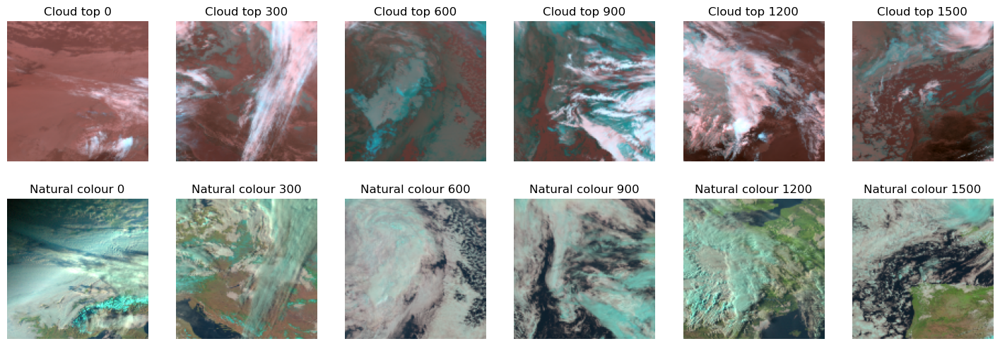

In [20]:
fig, axes = plt.subplots(2, 6, figsize=(18,6))

stride = 300

for i in range(6):
    cloudtop_image = plt.imread(cloudtop_daytime_files[i*stride])
    natural_colour_image = plt.imread(natural_colour_daytime_files[i*stride])
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(natural_colour_image)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'Natural colour {i*stride}')

In [21]:
# 5. Read metadata.csv and add nighttime as a column

patch_metadata = pd.read_csv(data_path/"metadata.csv")
patch_metadata["date"] = pd.to_datetime(patch_metadata.date)
patch_metadata["nighttime"] = is_nighttime

### Extension question possible answers:

In [22]:
# 6. Using pysolar to find the solar zenith angle for the centre of each patch and use it to filter the dark patches without relying on pixel values:
from pysolar.solar import get_altitude_fast

patch_metadata["solar_zenith_angle"] = 90 - get_altitude_fast(
    patch_metadata.latitude, patch_metadata.longitude, patch_metadata.date.dt.tz_localize('UTC')
)

# Set 75 degrees as the limit (15 degrees above the horizon) to avoid twilight

is_nighttime = patch_metadata.solar_zenith_angle>75
print(f'Total nighttime patches using solar zenth angle: {is_nighttime.sum()}')

patch_metadata["nighttime"] = is_nighttime

Total nighttime patches using solar zenth angle: 5609


In [23]:
patch_metadata

,cloudtop_file,natural_colour_file,date,longitude,latitude,nighttime,solar_zenith_angle
0,cloudtop_0000.png,natural_colour_0000.png,2019-01-01 00:00:00,-13.5,48.3,True,152.242710
1,cloudtop_0001.png,natural_colour_0001.png,2019-01-01 01:00:00,-17.5,37.0,True,165.707872
2,cloudtop_0002.png,natural_colour_0002.png,2019-01-01 02:00:00,19.0,46.7,True,134.916811
3,cloudtop_0003.png,natural_colour_0003.png,2019-01-01 03:00:00,-17.3,52.7,True,143.981539
4,cloudtop_0004.png,natural_colour_0004.png,2019-01-01 04:00:00,-20.5,50.4,True,139.441070
...,...,...,...,...,...,...,...
8755,cloudtop_8755.png,natural_colour_8755.png,2019-12-31 19:00:00,-16.7,47.1,True,104.999622
8756,cloudtop_8756.png,natural_colour_8756.png,2019-12-31 20:00:00,3.0,46.5,True,128.382509
8757,cloudtop_8757.png,natural_colour_8757.png,2019-12-31 21:00:00,-23.0,52.6,True,120.838916
8758,cloudtop_8758.png,natural_colour_8758.png,2019-12-31 22:00:00,-8.0,41.4,True,142.779543


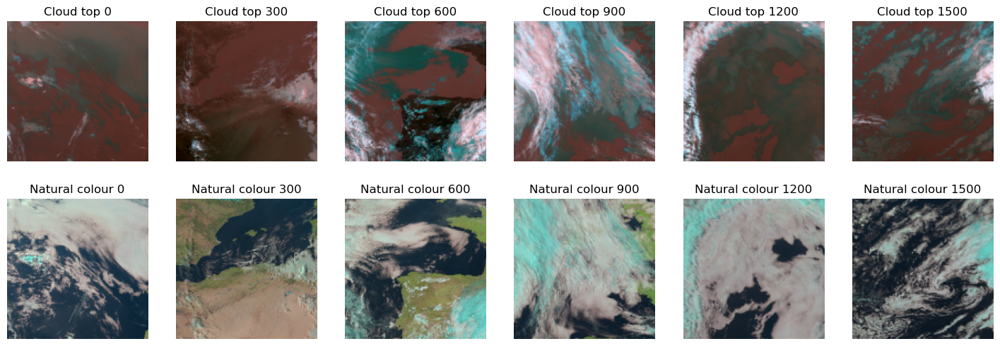

In [24]:
fig, axes = plt.subplots(2, 6, figsize=(18,6))

cloudtop_daytime_files = patch_metadata.cloudtop_file[~patch_metadata.nighttime].reset_index(drop=True)
natural_colour_daytime_files = patch_metadata.natural_colour_file[~patch_metadata.nighttime].reset_index(drop=True)

stride = 300

for i in range(6):
    cloudtop_image = plt.imread(cloudtop_path/cloudtop_daytime_files[i*stride])
    natural_colour_image = plt.imread(natural_colour_path/natural_colour_daytime_files[i*stride])
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(natural_colour_image)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'Natural colour {i*stride}')

7: Raw satellite imagery often has artifacts that may affect your training data. Sometimes these are filtered from the data, or quality flagged, but in other cases they may not be so you will have to filter them yourself. Examples of this include direct specular reflection on sunlight over the oceans when the sun angle and satellite viewing angle are aligned. Another issue may be periods of missing data

# 3. Splitting train, test and validation data

After data cleaning, an important step is to split the dataset into three separate train, validation and test datasets. A naive approch to this would be to cycle through the image pairs in sets of three, putting one into each of the datasets. However, we need to be wary that these images are also a time series, and that their is covariance between subsequent images and as a result we would be polluting our training dataset with data in the test and validation sets. Instead, let's simply split the dataset into three blocks:

In [25]:
# Open metadata.csv and add the nighttime column if not already done:
if "patch_metadata" not in locals():
    patch_metadata = pd.read_csv(data_path/"metadata.csv")
    patch_metadata["date"] = pd.to_datetime(patch_metadata.date)
if "nighttime" not in patch_metadata:
    patch_metadata["nighttime"] = is_nighttime

In [26]:
patch_metadata

,cloudtop_file,natural_colour_file,date,longitude,latitude,nighttime,solar_zenith_angle
0,cloudtop_0000.png,natural_colour_0000.png,2019-01-01 00:00:00,-13.5,48.3,True,152.242710
1,cloudtop_0001.png,natural_colour_0001.png,2019-01-01 01:00:00,-17.5,37.0,True,165.707872
2,cloudtop_0002.png,natural_colour_0002.png,2019-01-01 02:00:00,19.0,46.7,True,134.916811
3,cloudtop_0003.png,natural_colour_0003.png,2019-01-01 03:00:00,-17.3,52.7,True,143.981539
4,cloudtop_0004.png,natural_colour_0004.png,2019-01-01 04:00:00,-20.5,50.4,True,139.441070
...,...,...,...,...,...,...,...
8755,cloudtop_8755.png,natural_colour_8755.png,2019-12-31 19:00:00,-16.7,47.1,True,104.999622
8756,cloudtop_8756.png,natural_colour_8756.png,2019-12-31 20:00:00,3.0,46.5,True,128.382509
8757,cloudtop_8757.png,natural_colour_8757.png,2019-12-31 21:00:00,-23.0,52.6,True,120.838916
8758,cloudtop_8758.png,natural_colour_8758.png,2019-12-31 22:00:00,-8.0,41.4,True,142.779543


In [27]:
patch_metadata["split"] = ""

In [28]:
# Let's naively split the dataset into three
block_size = len(patch_metadata)//3

patch_metadata.loc[:block_size, "split"] = "train"

patch_metadata.loc[block_size:2*block_size, "split"] = "test"

patch_metadata.loc[2*block_size:3*block_size, "split"] = "validate"

# Remove nighttime patches
patch_metadata.loc[patch_metadata.nighttime, "split"] = ""

In [29]:
patch_metadata

,cloudtop_file,natural_colour_file,date,longitude,latitude,nighttime,solar_zenith_angle,split
0,cloudtop_0000.png,natural_colour_0000.png,2019-01-01 00:00:00,-13.5,48.3,True,152.242710,
1,cloudtop_0001.png,natural_colour_0001.png,2019-01-01 01:00:00,-17.5,37.0,True,165.707872,
2,cloudtop_0002.png,natural_colour_0002.png,2019-01-01 02:00:00,19.0,46.7,True,134.916811,
3,cloudtop_0003.png,natural_colour_0003.png,2019-01-01 03:00:00,-17.3,52.7,True,143.981539,
4,cloudtop_0004.png,natural_colour_0004.png,2019-01-01 04:00:00,-20.5,50.4,True,139.441070,
...,...,...,...,...,...,...,...,...
8755,cloudtop_8755.png,natural_colour_8755.png,2019-12-31 19:00:00,-16.7,47.1,True,104.999622,
8756,cloudtop_8756.png,natural_colour_8756.png,2019-12-31 20:00:00,3.0,46.5,True,128.382509,
8757,cloudtop_8757.png,natural_colour_8757.png,2019-12-31 21:00:00,-23.0,52.6,True,120.838916,
8758,cloudtop_8758.png,natural_colour_8758.png,2019-12-31 22:00:00,-8.0,41.4,True,142.779543,


In [30]:
(patch_metadata.split=="train").sum(), (patch_metadata.split=="test").sum(), (patch_metadata.split=="validate").sum()

(np.int64(944), np.int64(1412), np.int64(795))

Now create a new splits file and save to disk:

In [31]:
splits = patch_metadata.loc[patch_metadata.nighttime==False, ["cloudtop_file", "natural_colour_file", "split"]].reset_index(drop=True)

In [32]:
splits

,cloudtop_file,natural_colour_file,split
0,cloudtop_0011.png,natural_colour_0011.png,train
1,cloudtop_0012.png,natural_colour_0012.png,train
2,cloudtop_0013.png,natural_colour_0013.png,train
3,cloudtop_0015.png,natural_colour_0015.png,train
4,cloudtop_0035.png,natural_colour_0035.png,train
...,...,...,...
3146,cloudtop_8746.png,natural_colour_8746.png,validate
3147,cloudtop_8747.png,natural_colour_8747.png,validate
3148,cloudtop_8748.png,natural_colour_8748.png,validate
3149,cloudtop_8751.png,natural_colour_8751.png,validate


In [33]:
splits.to_csv("splits.csv", index=False)

This produces three datasets of nearly equal length. However this is far from the best way to do this

## Exercises:

1. Over what time scales do you think earth observation images have significant covariance with each other? Does this vary with the location or phenomena you are observing?
2. What issues might we face with EO data by splitting our datasets into completely discrete sections for train, test and validate?
3. What is a better choice for the size of each chunk of dataset to ensure good coverage of the full time series without covariance?
4. Use the `date` column of `metadata.csv` to create splits using days of the month. Consider what a good strategy for this is, and what impacts your choices make on model training

### Exercise solutions

In [34]:
# 3: solution use the first 10 days of each month for training, the next 10 days for validation and the remaining days for testing:

patch_metadata["split"] = ""

patch_metadata.loc[
    (patch_metadata.date.dt.day <= 10) & (~patch_metadata["nighttime"]), "split"
] = "train"

patch_metadata.loc[
    (10 < patch_metadata.date.dt.day) & (patch_metadata.date.dt.day <= 20) & (~patch_metadata["nighttime"]), "split"
] = "test"

patch_metadata.loc[
    (20 < patch_metadata.date.dt.day) & (~patch_metadata["nighttime"]), "split"
] = "validate"

print((patch_metadata.split=="train").sum(), (patch_metadata.split=="test").sum(), (patch_metadata.split=="validate").sum())

splits = patch_metadata.loc[patch_metadata.nighttime==False, ["cloudtop_file", "natural_colour_file", "split"]].reset_index(drop=True)

splits.to_csv("splits.csv", index=False)

1025 1028 1098


In [35]:
splits

,cloudtop_file,natural_colour_file,split
0,cloudtop_0011.png,natural_colour_0011.png,train
1,cloudtop_0012.png,natural_colour_0012.png,train
2,cloudtop_0013.png,natural_colour_0013.png,train
3,cloudtop_0015.png,natural_colour_0015.png,train
4,cloudtop_0035.png,natural_colour_0035.png,train
...,...,...,...
3146,cloudtop_8746.png,natural_colour_8746.png,validate
3147,cloudtop_8747.png,natural_colour_8747.png,validate
3148,cloudtop_8748.png,natural_colour_8748.png,validate
3149,cloudtop_8751.png,natural_colour_8751.png,validate


In [36]:
# 4 alternative solution, with the aim of increasing the proportion of training data, and reducing the chance of pollution between train and test datasets by adding a day spacing between each split:

patch_metadata["split"] = ""

# Days 1-13 go into the train split
patch_metadata.loc[
    (patch_metadata.date.dt.day < 14) & (~patch_metadata["nighttime"]), "split"
] = "train"

# Days 15-20 go into the validation split
patch_metadata.loc[
    (14 < patch_metadata.date.dt.day) & (patch_metadata.date.dt.day < 21) & (~patch_metadata["nighttime"]), "split"
] = "validate"

# Days 22-27 go into the test split
patch_metadata.loc[
    (21 < patch_metadata.date.dt.day) & (patch_metadata.date.dt.day < 28) & (~patch_metadata["nighttime"]), "split"
] = "test"

# Days 14, 21, and 28-31 are discarded

print((patch_metadata.split=="train").sum(), (patch_metadata.split=="test").sum(), (patch_metadata.split=="validate").sum())

splits = patch_metadata.loc[patch_metadata.nighttime==False, ["cloudtop_file", "natural_colour_file", "split"]].reset_index(drop=True)

splits.to_csv("splits.csv", index=False)

1333 627 608


# 4. Baseline

First, lets create a simple baseline to compare our models against. This is a naive solution based on analog methods (aka K-NN regression), but used here for regression instead of forecasting. The idea consists in taking for a test sample its nearest neighbor training cloud top image, then using its corresponding true colour image as the prediction.

In [37]:
# Load training data into memory
train_split = splits[splits.split=="train"].reset_index(drop=True)

cloudtop_train = np.stack([
    plt.imread(cloudtop_path/cloudtop_file)[...,:-1] for cloudtop_file in train_split.cloudtop_file
])

natural_colour_train = np.stack([
    plt.imread(natural_colour_path/natural_colour_file)[...,:-1] for natural_colour_file in train_split.natural_colour_file
])

In [38]:
# We can use the BallTree from scikit-learn to find nearest neighbours
from sklearn.neighbors import BallTree

# Now simply add all of our training dataset:
tree = BallTree(
    cloudtop_train.reshape((cloudtop_train.shape[0],-1)), 
    leaf_size=2
)

To use the model, we simply query the balltree object using the test image:

In [39]:
test_split = splits[splits.split=="test"].reset_index(drop=True)

In [40]:
# k sets the number of nearest neighbours to return. Here we set it to 1
test_image = plt.imread(cloudtop_path/test_split.cloudtop_file[0])[...,:-1]

dist, prediction = tree.query(test_image.reshape((1,-1)), k=1) 

# Print the closest (and only) neighbour
print(f'Closest match: image {prediction[0][0]}, distance: {dist[0][0]}')

Closest match: image 1289, distance: 38.642846957385366


Let's plot a few images to see what the predictions actually look like:

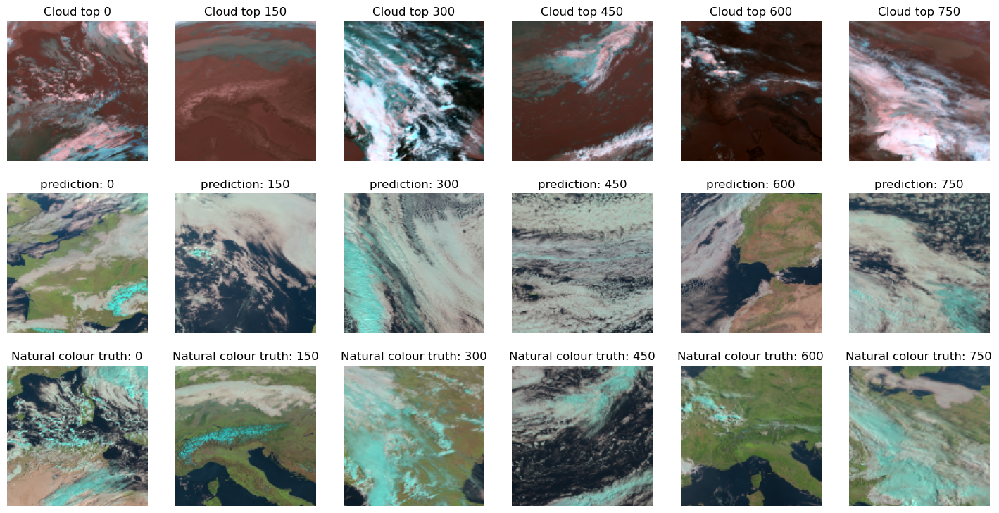

In [41]:
fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 100

for i in range(6):
    cloudtop_image = plt.imread(cloudtop_path/test_split.cloudtop_file[i*stride])[...,:-1]
    natural_colour_image = plt.imread(natural_colour_path/test_split.natural_colour_file[i*stride])[...,:-1]
    
    dist, prediction = tree.query(cloudtop_image.reshape((1,-1)), k=1) 

    prediction_image = plt.imread(natural_colour_path/train_split.natural_colour_file[prediction[0][0]])[...,:-1]
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*150}')
    
    axes[1, i].imshow(prediction_image)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*150}')

    axes[2, i].imshow(natural_colour_image)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*150}')


Surprisingly, some of these actually look quite close! However, as these all these predictions are real images, they look "right" to us even if they are not actually correct. How can we provide a more quantitative measure of the difference between the predictions and the true values?

# 5. Metrics

Metrics are important for evaluating any ML task. Here we will implement three different, commonly used metrics to see how they compare:

 - RMSE
 - PSNR
 - SSIM

In [42]:
import skimage.metrics

In [43]:
from skimage.metrics import mean_squared_error
from skimage.metrics import peak_signal_noise_ratio
from skimage.metrics import structural_similarity
# Define rmse
rmse = lambda img0, img1: mean_squared_error(img0, img1)**0.5
# Define options for ssim
from functools import partial
psnr = partial(peak_signal_noise_ratio, data_range=1)
ssim = partial(structural_similarity, data_range=1, channel_axis=-1)

Now, let's plot the same examples again and see what the scores are:

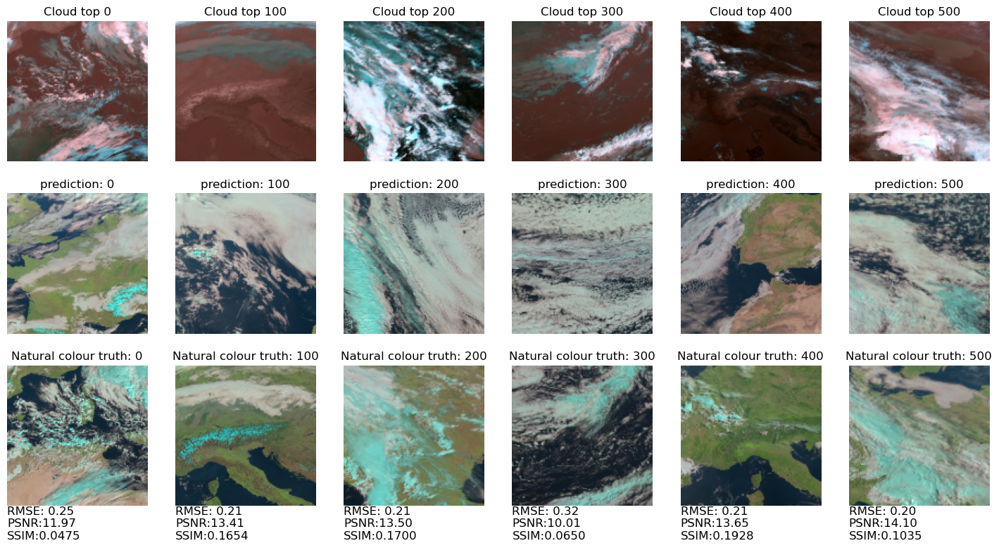

In [44]:
fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 100

for i in range(6):
    cloudtop_image = plt.imread(cloudtop_path/test_split.cloudtop_file[i*stride])[...,:-1]
    natural_colour_image = plt.imread(natural_colour_path/test_split.natural_colour_file[i*stride])[...,:-1]
    
    dist, prediction = tree.query(cloudtop_image.reshape((1,-1)), k=1) 

    prediction_image = plt.imread(natural_colour_path/train_split.natural_colour_file[prediction[0][0]])[...,:-1]
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(prediction_image)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*stride}')

    axes[2, i].imshow(natural_colour_image)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*stride}')

    fig.text(
        *axes[2,i].get_position().bounds[0:2], 
        f'RMSE: {rmse(prediction_image, natural_colour_image):.2f}' \
        f'\nPSNR:{psnr(prediction_image, natural_colour_image):.2f}' \
        f'\nSSIM:{ssim(prediction_image, natural_colour_image):.4f}',
        ha="left", va="top", fontsize=12
    )

For RMSE a low scores is better. For PSNR and SSIM, high scores are better. As we can see, none of the predictions score very well...

We can calculate the metrics over the entire test set (limit to the first 100, for time), to see how well we are performing overall

In [45]:
cloudtop_test = np.stack([
    plt.imread(cloudtop_path/cloudtop_file)[...,:-1] for cloudtop_file in test_split.cloudtop_file
])

natural_colour_test = np.stack([
    plt.imread(natural_colour_path/natural_colour_file)[...,:-1] for natural_colour_file in test_split.natural_colour_file
])

In [46]:
dist, prediction = tree.query(cloudtop_test[:100].reshape((100,-1)), k=1) 

pred_img = natural_colour_train[prediction[:,0]]
true_img = natural_colour_test[:100]

test_rmse = rmse(pred_img, true_img)
test_psnr = psnr(pred_img, true_img)
test_ssim = ssim(pred_img, true_img)
    
print(f'Mean RMSE: {np.mean(test_rmse)}, \nMean PSNR: {np.mean(test_psnr)}, \nMean SSIM: {np.mean(test_ssim)}')

Mean RMSE: 0.22936572291059407, 
Mean PSNR: 12.789429676651373, 
Mean SSIM: 0.18066249787807465


Overall, these poor results match what we saw in the individual images

## Exercises:

1. Compare each of the metrics to your own evaluation of the quality of the predictions. Which of the metrics do you think is the most useful for this task?
2. Instead of making a prediction based on one nearest neighbour, find the three nearest neighbours and average the result. Plot a few examples, and calculate the average RMSE, PSNR and SSIM of the predictions. Do you get better results? Do the predictions look realistic to you? What happens if you keep increasing the number of neighbours?

### Exercise answers

In [47]:
# 2: Average result for k nearest neighbours
def kNN_prediction(query_img, k):
    dists, predictions = tree.query(query_img.reshape((1,-1)), k=k) 
    return natural_colour_train[predictions].squeeze().mean(0)

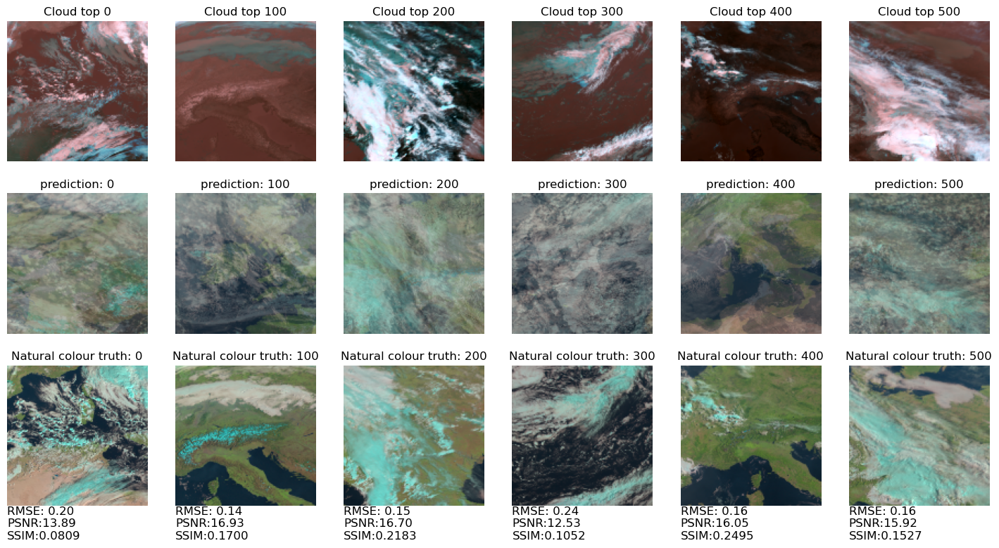

In [48]:
fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 100

for i in range(6):
    pred_img = kNN_prediction(cloudtop_test[i*stride], 3)
    true_img = natural_colour_test[i*stride]

    
    axes[0, i].imshow(cloudtop_test[i*stride])
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(pred_img)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*stride}')

    axes[2, i].imshow(true_img)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*stride}')

    fig.text(
        *axes[2,i].get_position().bounds[0:2], 
        f'RMSE: {rmse(pred_img, true_img):.2f}' \
        f'\nPSNR:{psnr(pred_img, true_img):.2f}' \
        f'\nSSIM:{ssim(pred_img, true_img):.4f}',
        ha="left", va="top", fontsize=12
    )

In [49]:
test_rmse = []
test_psnr = []
test_ssim = []

for i in range(min(cloudtop_test.shape[0], 100)):
    pred_img = kNN_prediction(cloudtop_test[i], 3)
    true_img = natural_colour_test[i]

    test_rmse.append(rmse(pred_img, true_img))
    test_psnr.append(psnr(pred_img, true_img))
    test_ssim.append(ssim(pred_img, true_img))
    
print(f'Mean RMSE: {np.mean(test_rmse)}, \nMean PSNR: {np.mean(test_psnr)}, \nMean SSIM: {np.mean(test_ssim)}')

Mean RMSE: 0.18691796756502185, 
Mean PSNR: 14.731054385943612, 
Mean SSIM: 0.18270424008369446


# 6. UNet pipeline

CNN models are widely used for regression tasks using images. An image-to-image translation model could be constructed by combining two CNNs to encode and then decode an imahge to produce a prediction. However, this doesn't work very well. As the depth of a CNN increases, the model learns larger scale patterns within the image, but also loses fine grained detail. As a result, you end up with a model that can produce a blurry prediction of the whole image with no details (see below):

<img src=media/CNN_image2image_blurry.png alt="Blurry CNN predictions" width=800>

The UNet model \[Ronneberger et al., 2015] uses CNNs as both the encoder and decoder. However, to preserve fine-grained details, "skip connections" are introduced which transfer information between the encoder and decoder at every depth level (see below):

<img src=media/unet.png alt="UNet architecture" width=800>

While the UNet was originally designed for image segmentation, it is also very good at image-to-image translation. 

In [50]:
import torch
from torch import nn
from lightning.pytorch import LightningModule

### 6.1 Convolution block

The basics unit of a UNet is a sequence of two convolutions, with a ReLU activation after each one:

In [51]:
class ConvBlock(LightningModule):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
        self.relu1  = nn.ReLU()
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.relu2  = nn.ReLU()
        self.layer = nn.Sequential(
            self.conv1, self.relu1, self.conv2, self.relu2
        )
    
    def forward(self, x):
        return self.layer(x)

### 6.2 Encoder

The UNet encoder consists of a series of convolution blocks to the required depth, with a 2x2 max pool operation between each to reduce the spatial scale of the data. The forward function returns a list of features produced by the convolution block at each depth

In [52]:
class UNetEncoder(LightningModule):
    def __init__(self, input_channels: int = 3, initial_layer_channels: int = 32, depth: int = 4):
        super().__init__()
        self.channels = [initial_layer_channels*2**i for i in range(depth+1)]
        
        self.input_block = ConvBlock(input_channels, initial_layer_channels)
        
        self.encode_blocks = nn.ModuleList(
            [ConvBlock(self.channels[i], self.channels[i+1]) for i in range(depth)]
        )
        self.pool = nn.MaxPool2d(2)
    
    def forward(self, x):
        features = []
        
        x = self.input_block(x)
        features.append(x)
        
        for block in self.encode_blocks:
            x = self.pool(x)
            x = block(x)
            features.append(x)
        return features[::-1]

### 6.3 Decoder

The decoder works similarly to the encoder, but uses `ConvTranspose2d` to upscale the spatial information. At each depth, the resul of the up-convolution is concatenated with the skip connection features from the encoder. Finally, a convolution is used to transform the output data into a 3 channel image, and the output is clipped to valid values between 0 and 1

In [53]:
class UNetDecoder(LightningModule):
    def __init__(self, output_channels=3, initial_layer_channels: int = 32, depth: int = 4):
        super().__init__()
        self.channels = [initial_layer_channels*2**i for i in range(depth+1)][::-1]
        self.upconvs = nn.ModuleList([
            nn.ConvTranspose2d(self.channels[i], self.channels[i+1], 2, 2) for i in range(len(self.channels)-1)
        ])
        self.decode_blocks = nn.ModuleList(
            [ConvBlock(self.channels[i], self.channels[i+1]) for i in range(len(self.channels)-1)]
        )
        self.head = nn.Conv2d(initial_layer_channels, output_channels, 1)
        
    def forward(self, x, features):
        for upconv, block, feature in zip(self.upconvs, self.decode_blocks, features):
            x = upconv(x)
            x = torch.cat([x, feature], dim=-3)
            x = block(x)
        x = self.head(x)
        return torch.clamp(x, min=0, max=1)


### 6.4 Full UNet model

The UNet model is created by combining the encoder and decoder:

In [54]:
class Image2Image_UNet(LightningModule):
    def __init__(
        self, 
        input_channels: int = 3, 
        output_channels: int = 3, 
        initial_layer_channels: int = 32, 
        depth: int = 4, 
        learning_rate: float = 1.5e-4,
        loss_function = nn.MSELoss()
    ):
        super().__init__()
        
        # Define encoder and decoder
        self.encoder = UNetEncoder(
            input_channels=input_channels, initial_layer_channels=initial_layer_channels, depth=depth
        )
        self.decoder = UNetDecoder(
            initial_layer_channels=initial_layer_channels, depth=depth
        )
        
        # define & log hyperparameters
        self.learning_rate = learning_rate
        self.save_hyperparameters(ignore=['loss_function'])

        # loss function
        self.loss = loss_function

    def forward(self, x):
        features = self.encoder(x)
        x = self.decoder(features[0], features[1:])
        return x

    def compute_loss(self, batch):
        image, target = batch
        # forward pass
        predictions = self(image).squeeze()
        # calculate loss
        loss = self.loss(predictions, target)
        return loss

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=self.learning_rate)
        return optimizer

    def training_step(self, batch, batch_idx):
        loss = self.compute_loss(batch)
        # log training loss
        self.log(
            "train_loss", loss, on_step=True, on_epoch=True, logger=True, prog_bar=True
        )
        return loss
    
    def validation_step(self, batch, batch_idx):
        loss = self.compute_loss(batch)
        # log validation loss
        self.log(
            "val_loss", loss, on_step=True, on_epoch=True, logger=True, prog_bar=True
        )
        return loss

    def test_step(self, batch, batch_idx):
        loss = self.compute_loss(batch)
        # log test loss
        self.log(
            "test_loss", loss, on_step=True, on_epoch=True, logger=True, prog_bar=True
        )
        return loss

### 6.5 Dataloader

Now we need to create a dataloader that can take our splits file we created earlier and return train, validate and test datasets:

In [55]:
from torch.utils.data import Dataset, DataLoader
from lightning.pytorch import LightningDataModule

class NightvisionDataset(Dataset):
    def __init__(self, cloudtop_files, natural_colour_files):

        super().__init__()
        
        self.cloudtop_files = cloudtop_files
        self.natural_colour_files = natural_colour_files

    def __len__(self):
        return len(self.cloudtop_files)
    
    def __getitem__(self, idx):
        return (
            plt.imread(self.cloudtop_files[idx])[...,:-1].transpose([2,0,1]).astype(np.float32), 
            plt.imread(self.natural_colour_files[idx])[...,:-1].transpose([2,0,1]).astype(np.float32), 
        )

class NightvisionDataloader(LightningDataModule):
    def __init__(
        self, 
        batch_size, 
        splits_file, 
        cloudtop_path, 
        natural_colour_path,
        num_workers=0, 
    ):
        super().__init__()
        self.batch_size = batch_size

        splits_df = pd.read_csv(splits_file)

        train_split = splits_df[splits_df.split=="train"]
        test_split = splits_df[splits_df.split=="test"]
        val_split = splits_df[splits_df.split=="validate"]

        # Get list of files for each split
        self.train_dataset = NightvisionDataset(
            [cloudtop_path/f for f in train_split.cloudtop_file], 
            [natural_colour_path/f for f in train_split.natural_colour_file], 
        )
        self.val_dataset = NightvisionDataset(
            [cloudtop_path/f for f in val_split.cloudtop_file], 
            [natural_colour_path/f for f in val_split.natural_colour_file], 
        )
        self.test_dataset = NightvisionDataset(
            [cloudtop_path/f for f in test_split.cloudtop_file], 
            [natural_colour_path/f for f in test_split.natural_colour_file], 
        )
        
        self.num_workers = num_workers

    def train_dataloader(self):
        return DataLoader(
            self.train_dataset, 
            batch_size=self.batch_size, 
            shuffle=True,
            pin_memory=True, 
            num_workers=self.num_workers, 
        )
    
    def val_dataloader(self):
        return DataLoader(
            self.val_dataset, 
            batch_size=self.batch_size, 
            shuffle=False,
            pin_memory=True, 
            num_workers=self.num_workers, 
        )
    
    def test_dataloader(self):
        return DataLoader(
            self.test_dataset, 
            batch_size=self.batch_size, 
            shuffle=False,
            pin_memory=True, 
            num_workers=self.num_workers, 
        )

In [56]:
from lightning.pytorch import Trainer
from lightning.pytorch.callbacks import TQDMProgressBar
from lightning.pytorch.loggers import CSVLogger
from tqdm import tqdm

class LitProgressBar(TQDMProgressBar):
    def init_validation_tqdm(self):
        bar = tqdm(            
            disable=True,            
        )
        return bar

# Add a logger for metrics and checkpoints
csv_logger = CSVLogger(
    save_dir='',
    name='logs'
)


In [57]:
from lightning.pytorch import seed_everything

# Fix seed to compare experiments
_ = seed_everything(0)

Seed set to 0


In [58]:
# Initilise dataloader
dl = NightvisionDataloader(
    24, "splits.csv", data_path/"cloudtop_patches", data_path/"natural_colour_patches", 
)

In [59]:
# Initialise UNet model
unet = Image2Image_UNet(learning_rate=2e-4)

In [60]:
# Initialize the trainer
trainer = Trainer(
    max_epochs=10,
    callbacks=[LitProgressBar()],
    logger=csv_logger,
    log_every_n_steps=10, 
    accelerator="auto", 
)

GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


In [61]:
# Run training
trainer.fit(unet, dl)


  | Name    | Type        | Params | Mode 
------------------------------------------------
0 | encoder | UNetEncoder | 4.7 M  | train
1 | decoder | UNetDecoder | 3.0 M  | train
2 | loss    | MSELoss     | 0      | train
------------------------------------------------
7.8 M     Trainable params
0         Non-trainable params
7.8 M     Total params
31.041    Total estimated model params size (MB)
66        Modules in train mode
0         Modules in eval mode


Sanity Checking: |                                                                                                              | 0/? [00:00<?, ?it/s]

/Users/jonesw/miniforge3/envs/iecdt-earth-obs/lib/python3.13/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=10` in the `DataLoader` to improve performance.


/Users/jonesw/miniforge3/envs/iecdt-earth-obs/lib/python3.13/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=10` in the `DataLoader` to improve performance.


Epoch 9: 100%|█| 56/56 [00:16<00:00,  3.32it/s, v_num=0, train_loss_step=0.0129, val_loss_step=0.0114, val_loss_epoch=0.0117, train_loss_epoch=0.0119]

`Trainer.fit` stopped: `max_epochs=10` reached.


Epoch 9: 100%|█| 56/56 [00:16<00:00,  3.30it/s, v_num=0, train_loss_step=0.0129, val_loss_step=0.0114, val_loss_epoch=0.0117, train_loss_epoch=0.0119]


In [62]:
# compute validation metrics on the best model
trainer.validate(unet, dl.val_dataloader())

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
     Validate metric           DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
     val_loss_epoch        0.011687081307172775
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


[{'val_loss_epoch': 0.011687081307172775}]

In [63]:
unet.eval()

Image2Image_UNet(
  (encoder): UNetEncoder(
    (input_block): ConvBlock(
      (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu1): ReLU()
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu2): ReLU()
      (layer): Sequential(
        (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): ReLU()
        (2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (3): ReLU()
      )
    )
    (encode_blocks): ModuleList(
      (0): ConvBlock(
        (conv1): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (relu1): ReLU()
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (relu2): ReLU()
        (layer): Sequential(
          (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): ReLU()
          (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
 

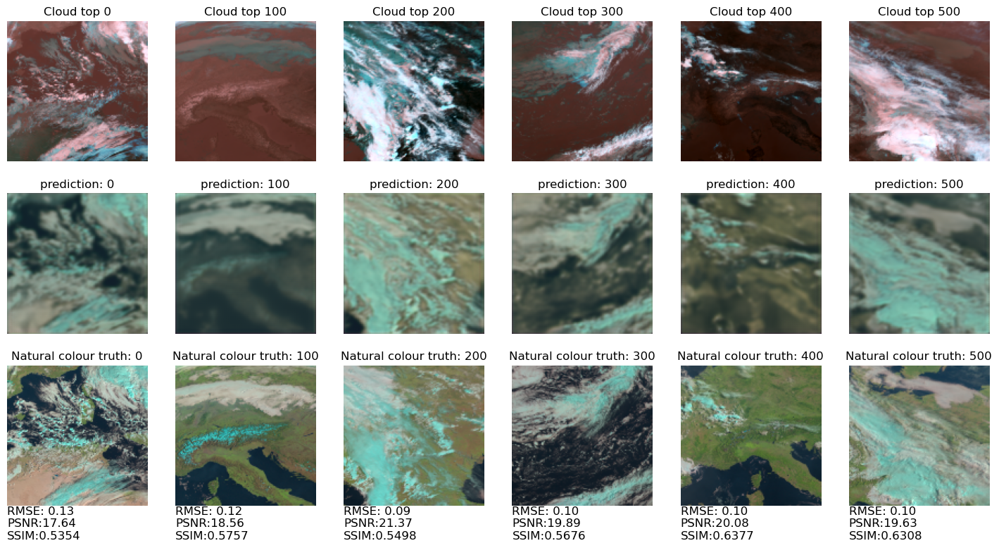

In [64]:
def unet_prediction(image):
    in_img = torch.from_numpy(
        (image.transpose(2,0,1)).astype(np.float32)
    )
    out_img = unet.forward(in_img)
    out_img = out_img.detach().numpy().transpose(1,2,0)
    out_img = np.clip(out_img, 0, 1)
    return out_img

fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 100

for i in range(6):
    cloudtop_image = plt.imread(cloudtop_path/test_split.cloudtop_file[i*stride])[...,:-1]
    natural_colour_image = plt.imread(natural_colour_path/test_split.natural_colour_file[i*stride])[...,:-1]
    
    prediction_image = unet_prediction(cloudtop_image)
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(prediction_image)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*stride}')

    axes[2, i].imshow(natural_colour_image)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*stride}')

    fig.text(
        *axes[2,i].get_position().bounds[0:2], 
        f'RMSE: {rmse(prediction_image, natural_colour_image):.2f}' \
        f'\nPSNR:{psnr(prediction_image, natural_colour_image):.2f}' \
        f'\nSSIM:{ssim(prediction_image, natural_colour_image):.4f}',
        ha="left", va="top", fontsize=12
    )

In [65]:
def unet_multi_prediction(image):
    in_img = torch.from_numpy(
        (image.transpose(0,3,1,2)).astype(np.float32)
    )
    out_img = unet.forward(in_img)
    out_img = out_img.detach().numpy().transpose(0,2,3,1)
    out_img = np.clip(out_img, 0, 1)
    return out_img

pred_img = unet_multi_prediction(cloudtop_test[::10])
true_img = natural_colour_test[::10]

test_rmse = rmse(pred_img, true_img)
test_psnr = psnr(pred_img, true_img)
test_ssim = ssim(pred_img, true_img)
    
print(f'Mean RMSE: {np.mean(test_rmse)}, \nMean PSNR: {np.mean(test_psnr)}, \nMean SSIM: {np.mean(test_ssim)}')

Mean RMSE: 0.10830502983881754, 
Mean PSNR: 19.30702747312268, 
Mean SSIM: 0.7812679409980774


### Exercises:
  
  1. Plot some predictions for actual night time images. How good do they look?

  2. Implement SSIM as a loss function and run the model using it instead of MSE. Does it improve the predictions?
  <details>
    <summary>Hints:</summary>
      - For SSIM, higher is better, so to minimise the loss you will have to return 1 - SSIM
      - SSIM only works on one channel. To calculate the SSIM over a multi channel image, calculate the SSIM for each channel separately then average them
      - Remember to set data range to 1!
  </details>

  3. Batch normalisation and dropout layers can help generalise UNet models. Implement these into the convolution block and test the results. What is a good choice for the dropout rate?

  4. Run your best model for more epochs. What is the best score you can achieve? Does the model overfit?

Extension exercises:

  5. Deep residual UNets \[Zhang et al., 2017] use residual units to improve predictions. Write a residual block module and use it in place of the convolution block to train a model.

  6. An issue with the UNet arhcitecure is that higher depths pass through fewer training layers. The UNet++ model \[Zhou et al. 2018] addresses this using nested skip connections. Implement a UNet++ model and compare the results

  7. Generative models are also widely used for image to image translation. Which models would be suitable for this task? If you have time, implement one!

### Exercise answers:

#### 1: Run predictions for night time images

In [66]:
# Get a list of the nighttime images
splits_night = patch_metadata[patch_metadata.nighttime==True].reset_index(drop=True)

In [67]:
splits_night

,cloudtop_file,natural_colour_file,date,longitude,latitude,nighttime,solar_zenith_angle,split
0,cloudtop_0000.png,natural_colour_0000.png,2019-01-01 00:00:00,-13.5,48.3,True,152.242710,
1,cloudtop_0001.png,natural_colour_0001.png,2019-01-01 01:00:00,-17.5,37.0,True,165.707872,
2,cloudtop_0002.png,natural_colour_0002.png,2019-01-01 02:00:00,19.0,46.7,True,134.916811,
3,cloudtop_0003.png,natural_colour_0003.png,2019-01-01 03:00:00,-17.3,52.7,True,143.981539,
4,cloudtop_0004.png,natural_colour_0004.png,2019-01-01 04:00:00,-20.5,50.4,True,139.441070,
...,...,...,...,...,...,...,...,...
5604,cloudtop_8755.png,natural_colour_8755.png,2019-12-31 19:00:00,-16.7,47.1,True,104.999622,
5605,cloudtop_8756.png,natural_colour_8756.png,2019-12-31 20:00:00,3.0,46.5,True,128.382509,
5606,cloudtop_8757.png,natural_colour_8757.png,2019-12-31 21:00:00,-23.0,52.6,True,120.838916,
5607,cloudtop_8758.png,natural_colour_8758.png,2019-12-31 22:00:00,-8.0,41.4,True,142.779543,


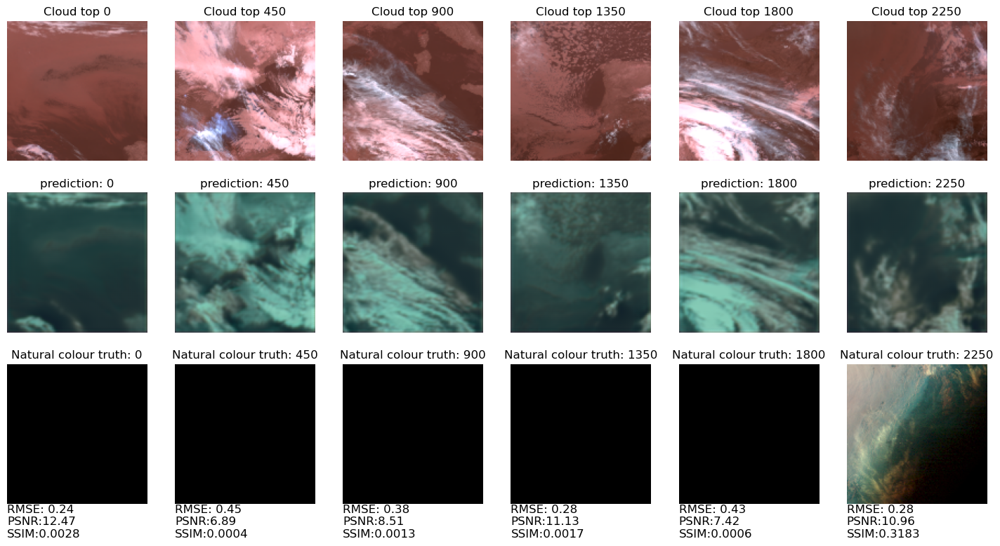

In [69]:
fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 450

for i in range(6):
    natural_colour_image = plt.imread(natural_colour_path/splits_night.natural_colour_file[i*stride])[...,:-1]
    cloudtop_image = plt.imread(cloudtop_path/splits_night.cloudtop_file[i*stride])[...,:-1]
    
    pred_img = unet_prediction(cloudtop_image)
    true_img = natural_colour_image
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(pred_img)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*stride}')

    axes[2, i].imshow(true_img)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*stride}')

    fig.text(
        *axes[2,i].get_position().bounds[0:2], 
        f'RMSE: {rmse(pred_img, true_img):.2f}' \
        f'\nPSNR:{psnr(pred_img, true_img):.2f}' \
        f'\nSSIM:{ssim(pred_img, true_img):.4f}',
        ha="left", va="top", fontsize=12
    )

There's some skill here, but all the predictions look very blue

#### 2: Using SSIM as the loss function

In [70]:
from torchmetrics.image import StructuralSimilarityIndexMeasure

# The built in SSIM metric for torch only works on a single channel, so we need to create a new loss module that calculates loss over each channel separately and then averages the result

class SSIMLoss(StructuralSimilarityIndexMeasure):
    def forward(self, x, y):
        channels = x.shape[-3]
        return 1 - torch.mean(
            torch.stack([
                super().forward(x[...,i:i+1,:,:], y[...,i:i+1,:,:]) for i in range(channels)
            ])
        )

# It also returns 1-SSIM so that we can minimise the result

In [71]:
# Now train a model with SSIM as the loss function
_ = seed_everything(0)

unet_ssim = Image2Image_UNet(
    loss_function=SSIMLoss(data_range=1), 
    learning_rate=1.5e-4, 
)

# Initialize the trainer
trainer = Trainer(
    max_epochs=10,
    callbacks=[LitProgressBar()],
    logger=csv_logger,
    accelerator="auto"
)

trainer.fit(unet_ssim, dl)

Seed set to 0
GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Users/jonesw/miniforge3/envs/iecdt-earth-obs/lib/python3.13/site-packages/lightning/pytorch/callbacks/model_checkpoint.py:654: Checkpoint directory logs/version_0/checkpoints exists and is not empty.

  | Name    | Type        | Params | Mode 
------------------------------------------------
0 | encoder | UNetEncoder | 4.7 M  | train
1 | decoder | UNetDecoder | 3.0 M  | train
2 | loss    | SSIMLoss    | 0      | train
------------------------------------------------
7.8 M     Trainable params
0         Non-trainable params
7.8 M     Total params
31.041    Total estimated model params size (MB)
66        Modules in train mode
0         Modules in eval mode


Sanity Checking DataLoader 0:   0%|                                                                                             | 0/2 [00:00<?, ?it/s]

/Users/jonesw/miniforge3/envs/iecdt-earth-obs/lib/python3.13/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=10` in the `DataLoader` to improve performance.


/Users/jonesw/miniforge3/envs/iecdt-earth-obs/lib/python3.13/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=10` in the `DataLoader` to improve performance.


Epoch 9: 100%|█████| 56/56 [00:18<00:00,  2.96it/s, v_num=0, train_loss_step=0.275, val_loss_step=0.318, val_loss_epoch=0.281, train_loss_epoch=0.276]

`Trainer.fit` stopped: `max_epochs=10` reached.


Epoch 9: 100%|█████| 56/56 [00:19<00:00,  2.94it/s, v_num=0, train_loss_step=0.275, val_loss_step=0.318, val_loss_epoch=0.281, train_loss_epoch=0.276]


In [72]:
# compute validation metrics on the best model
trainer.validate(unet_ssim, dl.val_dataloader())
unet_ssim.eval()

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
     Validate metric           DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
     val_loss_epoch         0.2807340919971466
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


Image2Image_UNet(
  (encoder): UNetEncoder(
    (input_block): ConvBlock(
      (conv1): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu1): ReLU()
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (relu2): ReLU()
      (layer): Sequential(
        (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): ReLU()
        (2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (3): ReLU()
      )
    )
    (encode_blocks): ModuleList(
      (0): ConvBlock(
        (conv1): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (relu1): ReLU()
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (relu2): ReLU()
        (layer): Sequential(
          (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): ReLU()
          (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
 

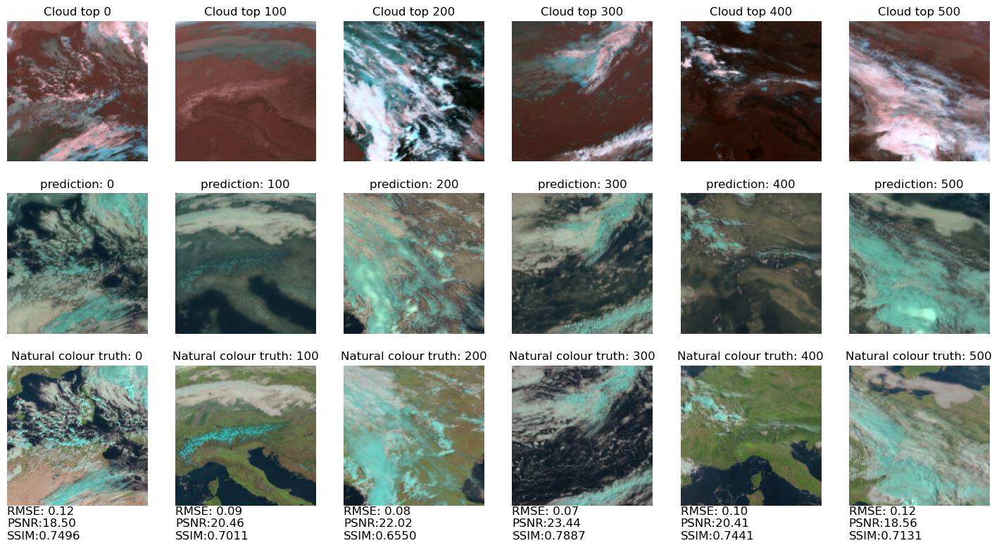

In [73]:
def unet_ssim_prediction(image):
    in_img = torch.from_numpy(
        (image.transpose(2,0,1)).astype(np.float32)
    )
    out_img = unet_ssim.forward(in_img)
    out_img = out_img.detach().numpy().transpose(1,2,0)
    out_img = np.clip(out_img, 0, 1)
    return out_img

fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 100

for i in range(6):
    cloudtop_image = plt.imread(cloudtop_path/test_split.cloudtop_file[i*stride])[...,:-1]
    natural_colour_image = plt.imread(natural_colour_path/test_split.natural_colour_file[i*stride])[...,:-1]
    
    prediction_image = unet_ssim_prediction(cloudtop_image)
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(prediction_image)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*stride}')

    axes[2, i].imshow(natural_colour_image)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*stride}')

    fig.text(
        *axes[2,i].get_position().bounds[0:2], 
        f'RMSE: {rmse(prediction_image, natural_colour_image):.2f}' \
        f'\nPSNR:{psnr(prediction_image, natural_colour_image):.2f}' \
        f'\nSSIM:{ssim(prediction_image, natural_colour_image):.4f}',
        ha="left", va="top", fontsize=12
    )

In [74]:
def unet_ssim_multi_prediction(image):
    in_img = torch.from_numpy(
        (image.transpose(0,3,1,2)).astype(np.float32)
    )
    out_img = unet_ssim.forward(in_img)
    out_img = out_img.detach().numpy().transpose(0,2,3,1)
    out_img = np.clip(out_img, 0, 1)
    return out_img

pred_img = unet_ssim_multi_prediction(cloudtop_test[::10])
true_img = natural_colour_test[::10]

test_rmse = rmse(pred_img, true_img)
test_psnr = psnr(pred_img, true_img)
test_ssim = ssim(pred_img, true_img)
    
print(f'Mean RMSE: {np.mean(test_rmse)}, \nMean PSNR: {np.mean(test_psnr)}, \nMean SSIM: {np.mean(test_ssim)}')

Mean RMSE: 0.09900377446892433, 
Mean PSNR: 20.086964956578672, 
Mean SSIM: 0.8543316721916199


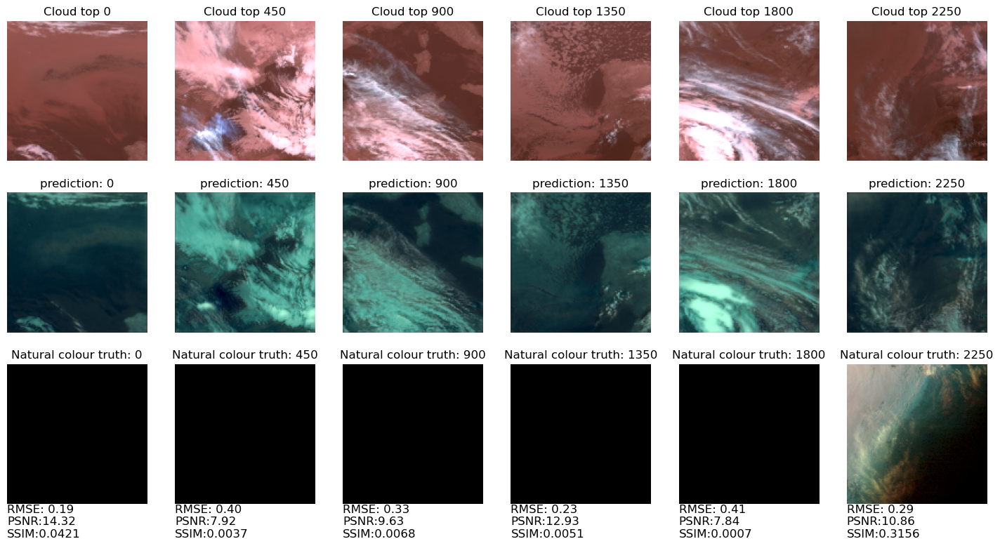

In [75]:
fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 450

for i in range(6):
    natural_colour_image = plt.imread(natural_colour_path/splits_night.natural_colour_file[i*stride])[...,:-1]
    cloudtop_image = plt.imread(cloudtop_path/splits_night.cloudtop_file[i*stride])[...,:-1]
    
    pred_img = unet_ssim_prediction(cloudtop_image)
    true_img = natural_colour_image
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(pred_img)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*stride}')

    axes[2, i].imshow(true_img)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*stride}')

    fig.text(
        *axes[2,i].get_position().bounds[0:2], 
        f'RMSE: {rmse(pred_img, true_img):.2f}' \
        f'\nPSNR:{psnr(pred_img, true_img):.2f}' \
        f'\nSSIM:{ssim(pred_img, true_img):.4f}',
        ha="left", va="top", fontsize=12
    )

In [76]:
from torchmetrics.image import StructuralSimilarityIndexMeasure

# Squaring the individual channel losses might help avoid situations where one channel is particularly bad

class SSIMSquaredLoss(StructuralSimilarityIndexMeasure):
    def forward(self, x, y):
        channels = x.shape[-3]
        return 1 - torch.mean(
            torch.stack([
                super().forward(x[...,i:i+1,:,:], y[...,i:i+1,:,:]) for i in range(channels)
            ])**2
        )

# It also returns 1-SSIM so that we can minimise the result

In [77]:
# Now train a model with SSIM as the loss function
_ = seed_everything(0)

unet_ssim2 = Image2Image_UNet(
    loss_function=SSIMSquaredLoss(data_range=1), 
    learning_rate=2e-4, 
)

# Initialize the trainer
trainer = Trainer(
    max_epochs=10,
    callbacks=[LitProgressBar()],
    logger=csv_logger,
    accelerator="auto"
)

trainer.fit(unet_ssim2, dl)

Seed set to 0
GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs

  | Name    | Type            | Params | Mode 
----------------------------------------------------
0 | encoder | UNetEncoder     | 4.7 M  | train
1 | decoder | UNetDecoder     | 3.0 M  | train
2 | loss    | SSIMSquaredLoss | 0      | train
----------------------------------------------------
7.8 M     Trainable params
0         Non-trainable params
7.8 M     Total params
31.041    Total estimated model params size (MB)
66        Modules in train mode
0         Modules in eval mode


Epoch 9: 100%|█████| 56/56 [00:18<00:00,  3.03it/s, v_num=0, train_loss_step=0.453, val_loss_step=0.503, val_loss_epoch=0.451, train_loss_epoch=0.447]

`Trainer.fit` stopped: `max_epochs=10` reached.


Epoch 9: 100%|█████| 56/56 [00:18<00:00,  3.01it/s, v_num=0, train_loss_step=0.453, val_loss_step=0.503, val_loss_epoch=0.451, train_loss_epoch=0.447]


In [78]:
# compute validation metrics on the best model
trainer.validate(unet_ssim2, dl.val_dataloader())
_ = unet_ssim2.eval()

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
     Validate metric           DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
     val_loss_epoch         0.45092588663101196
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


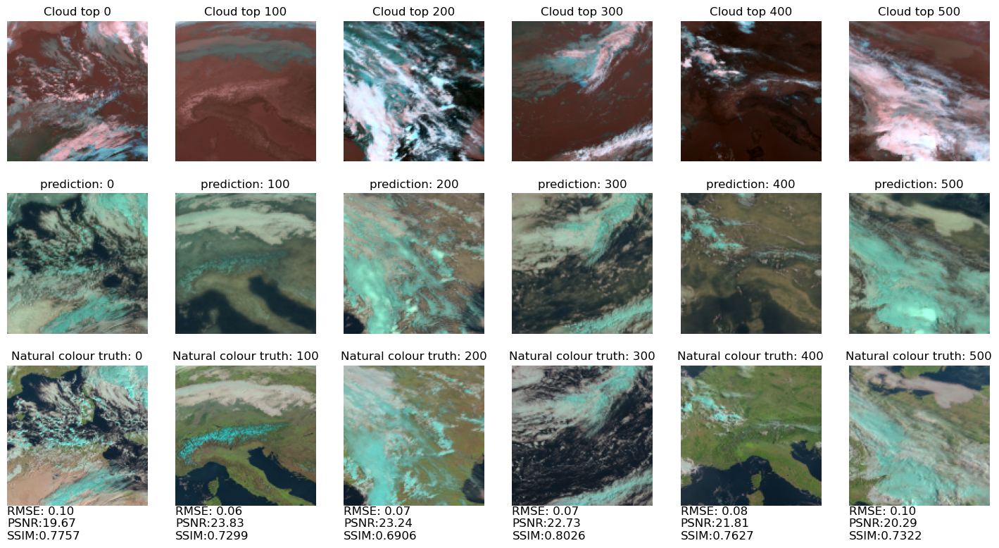

In [79]:
def unet_ssim2_prediction(image):
    in_img = torch.from_numpy(
        (image.transpose(2,0,1)).astype(np.float32)
    )
    out_img = unet_ssim2.forward(in_img)
    out_img = out_img.detach().numpy().transpose(1,2,0)
    out_img = np.clip(out_img, 0, 1)
    return out_img

fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 100

for i in range(6):
    cloudtop_image = plt.imread(cloudtop_path/test_split.cloudtop_file[i*stride])[...,:-1]
    natural_colour_image = plt.imread(natural_colour_path/test_split.natural_colour_file[i*stride])[...,:-1]
    
    prediction_image = unet_ssim2_prediction(cloudtop_image)
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(prediction_image)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*stride}')

    axes[2, i].imshow(natural_colour_image)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*stride}')

    fig.text(
        *axes[2,i].get_position().bounds[0:2], 
        f'RMSE: {rmse(prediction_image, natural_colour_image):.2f}' \
        f'\nPSNR:{psnr(prediction_image, natural_colour_image):.2f}' \
        f'\nSSIM:{ssim(prediction_image, natural_colour_image):.4f}',
        ha="left", va="top", fontsize=12
    )

In [80]:
def unet_ssim2_multi_prediction(image):
    in_img = torch.from_numpy(
        (image.transpose(0,3,1,2)).astype(np.float32)
    )
    out_img = unet_ssim2.forward(in_img)
    out_img = out_img.detach().numpy().transpose(0,2,3,1)
    out_img = np.clip(out_img, 0, 1)
    return out_img

pred_img = unet_ssim2_multi_prediction(cloudtop_test[::10])
true_img = natural_colour_test[::10]

test_rmse = rmse(pred_img, true_img)
test_psnr = psnr(pred_img, true_img)
test_ssim = ssim(pred_img, true_img)
    
print(f'Mean RMSE: {np.mean(test_rmse)}, \nMean PSNR: {np.mean(test_psnr)}, \nMean SSIM: {np.mean(test_ssim)}')

Mean RMSE: 0.08962764887503051, 
Mean PSNR: 20.951159918017737, 
Mean SSIM: 0.8683344721794128


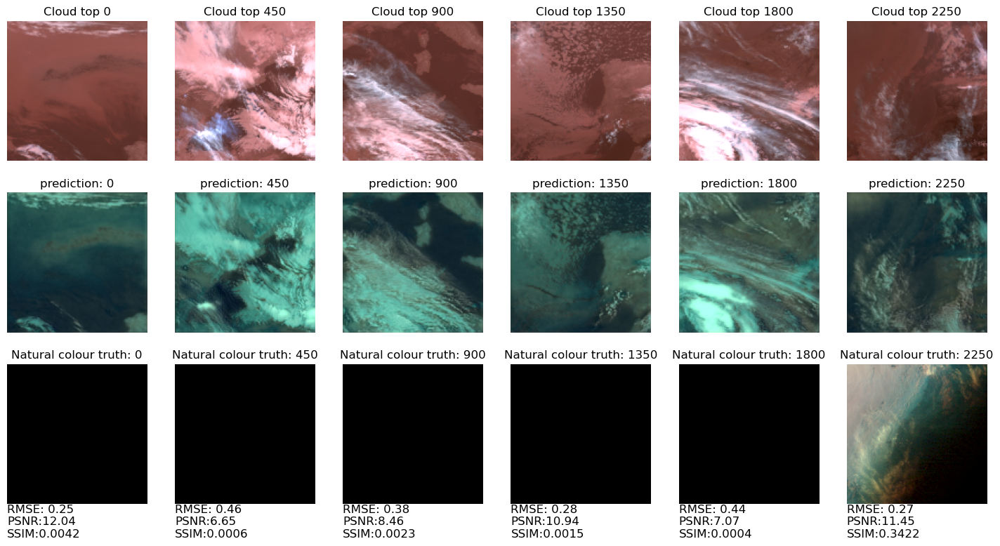

In [81]:
fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 450

for i in range(6):
    natural_colour_image = plt.imread(natural_colour_path/splits_night.natural_colour_file[i*stride])[...,:-1]
    cloudtop_image = plt.imread(cloudtop_path/splits_night.cloudtop_file[i*stride])[...,:-1]
    
    pred_img = unet_ssim2_prediction(cloudtop_image)
    true_img = natural_colour_image
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(pred_img)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*stride}')

    axes[2, i].imshow(true_img)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*stride}')

    fig.text(
        *axes[2,i].get_position().bounds[0:2], 
        f'RMSE: {rmse(pred_img, true_img):.2f}' \
        f'\nPSNR:{psnr(pred_img, true_img):.2f}' \
        f'\nSSIM:{ssim(pred_img, true_img):.4f}',
        ha="left", va="top", fontsize=12
    )

Squaring the individual channel losses definitely makes the images appear better, but it only has marginal improvements on the overall metric evaluation

#### 3: Adding batch normalisation and dropout layers to improve generalisation

These are added to the convolution block

In [82]:
class ConvBlock(LightningModule):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.norm1 = nn.BatchNorm2d(in_ch)
        self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
        self.relu1 = nn.ReLU()
        self.norm2 = nn.BatchNorm2d(out_ch)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.relu2 = nn.ReLU()
        self.dropout = nn.Dropout2d(p=0.05) # keep 95% at each block
        
        self.block = nn.Sequential(
            self.norm1, self.conv1, self.relu1, self.norm2, self.conv2, self.relu2, self.dropout
        )
    
    def forward(self, x):
        return self.block(x)

In [83]:
# Now train a model with batch normalisation and dropoiut layers
_ = seed_everything(0)

unet_norm = Image2Image_UNet(
    loss_function=SSIMSquaredLoss(data_range=1), 
    learning_rate=2e-4, 
)

# Initialize the trainer
trainer = Trainer(
    max_epochs=10,
    callbacks=[LitProgressBar()],
    logger=csv_logger,
    accelerator="auto"
)

trainer.fit(unet_norm, dl)

Seed set to 0
GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs

  | Name    | Type            | Params | Mode 
----------------------------------------------------
0 | encoder | UNetEncoder     | 4.7 M  | train
1 | decoder | UNetDecoder     | 3.1 M  | train
2 | loss    | SSIMSquaredLoss | 0      | train
----------------------------------------------------
7.8 M     Trainable params
0         Non-trainable params
7.8 M     Total params
31.064    Total estimated model params size (MB)
93        Modules in train mode
0         Modules in eval mode


Epoch 9: 100%|█████| 56/56 [00:21<00:00,  2.63it/s, v_num=0, train_loss_step=0.442, val_loss_step=0.430, val_loss_epoch=0.417, train_loss_epoch=0.440]

`Trainer.fit` stopped: `max_epochs=10` reached.


Epoch 9: 100%|█████| 56/56 [00:21<00:00,  2.61it/s, v_num=0, train_loss_step=0.442, val_loss_step=0.430, val_loss_epoch=0.417, train_loss_epoch=0.440]


In [84]:
# compute validation metrics on the best model
trainer.validate(unet_norm, dl.val_dataloader())
_ = unet_norm.eval()

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
     Validate metric           DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
     val_loss_epoch         0.4169934093952179
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


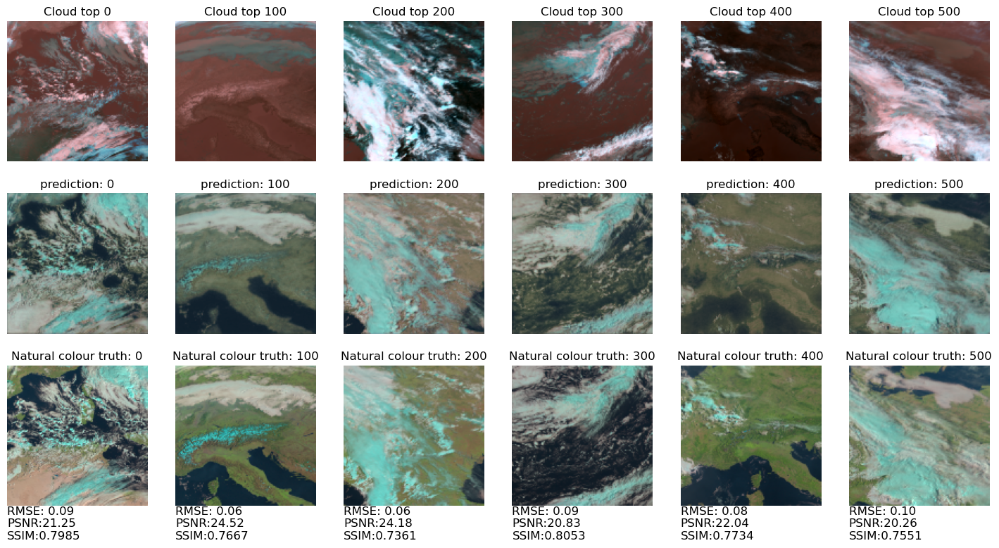

In [85]:
def unet_norm_prediction(image):
    in_img = torch.from_numpy(
        (image.transpose(2,0,1)).astype(np.float32)[np.newaxis]
    )
    out_img = unet_norm.forward(in_img)
    out_img = out_img.detach().numpy().squeeze().transpose(1,2,0)
    out_img = np.clip(out_img, 0, 1)
    return out_img

fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 100

for i in range(6):
    cloudtop_image = plt.imread(cloudtop_path/test_split.cloudtop_file[i*stride])[...,:-1]
    natural_colour_image = plt.imread(natural_colour_path/test_split.natural_colour_file[i*stride])[...,:-1]
    
    prediction_image = unet_norm_prediction(cloudtop_image)
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(prediction_image)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*stride}')

    axes[2, i].imshow(natural_colour_image)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*stride}')

    fig.text(
        *axes[2,i].get_position().bounds[0:2], 
        f'RMSE: {rmse(prediction_image, natural_colour_image):.2f}' \
        f'\nPSNR:{psnr(prediction_image, natural_colour_image):.2f}' \
        f'\nSSIM:{ssim(prediction_image, natural_colour_image):.4f}',
        ha="left", va="top", fontsize=12
    )

In [86]:
def unet_norm_multi_prediction(image):
    in_img = torch.from_numpy(
        (image.transpose(0,3,1,2)).astype(np.float32)
    )
    out_img = unet_norm.forward(in_img)
    out_img = out_img.detach().numpy().transpose(0,2,3,1)
    out_img = np.clip(out_img, 0, 1)
    return out_img

pred_img = unet_norm_multi_prediction(cloudtop_test[::10])
true_img = natural_colour_test[::10]

test_rmse = rmse(pred_img, true_img)
test_psnr = psnr(pred_img, true_img)
test_ssim = ssim(pred_img, true_img)
    
print(f'Mean RMSE: {np.mean(test_rmse)}, \nMean PSNR: {np.mean(test_psnr)}, \nMean SSIM: {np.mean(test_ssim)}')

Mean RMSE: 0.08376486260291156, 
Mean PSNR: 21.538762390596865, 
Mean SSIM: 0.88107830286026


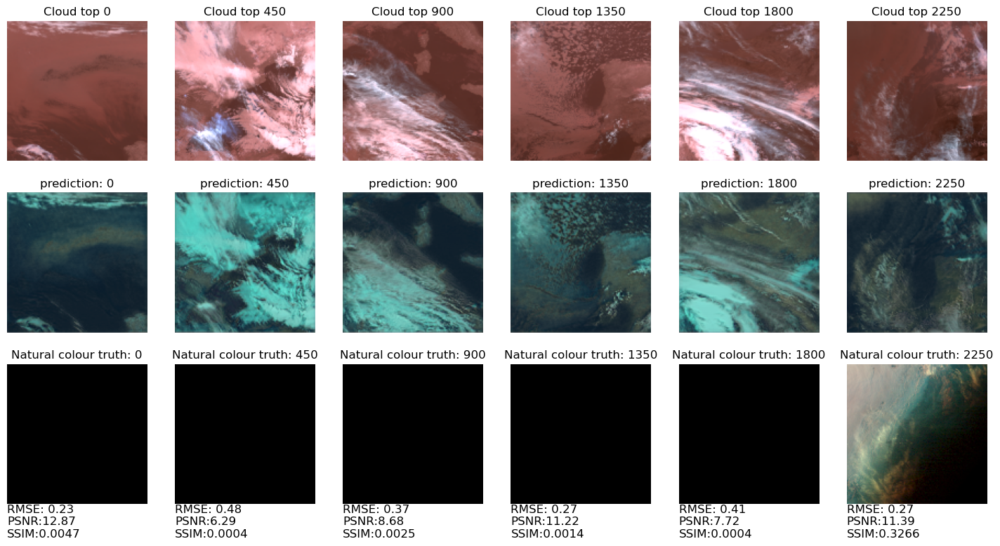

In [87]:
fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 450

for i in range(6):
    natural_colour_image = plt.imread(natural_colour_path/splits_night.natural_colour_file[i*stride])[...,:-1]
    cloudtop_image = plt.imread(cloudtop_path/splits_night.cloudtop_file[i*stride])[...,:-1]
    
    pred_img = unet_norm_prediction(cloudtop_image)
    true_img = natural_colour_image
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(pred_img)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*stride}')

    axes[2, i].imshow(true_img)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*stride}')

    fig.text(
        *axes[2,i].get_position().bounds[0:2], 
        f'RMSE: {rmse(pred_img, true_img):.2f}' \
        f'\nPSNR:{psnr(pred_img, true_img):.2f}' \
        f'\nSSIM:{ssim(pred_img, true_img):.4f}',
        ha="left", va="top", fontsize=12
    )

Introducing the batch normalisation and dropout layers again helped marginally improve the model. However, it also made the training slower. This raises the question, if training time is limited, is it better to train a more complex model for fewer epochs, or a less complex model for more epochs?

#### 4: Train for longer

We will test the model with batch normalisation and dropout layers for 30 epochs, and without for 40 epochs (which should take approximately the same time). To help the model reach an optimal solution when running for longer, we will add `ReduceLROnPlateau` to the optimiser configuration

In [88]:
# First, the convolution block without batch norm and dropout:
class ConvBlock(LightningModule):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
        self.relu1  = nn.ReLU()
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.relu2  = nn.ReLU()
        self.layer = nn.Sequential(
            self.conv1, self.relu1, self.conv2, self.relu2
        )
    
    def forward(self, x):
        return self.layer(x)

from torch.optim.lr_scheduler import ReduceLROnPlateau

class Image2Image_UNet(LightningModule):
    def __init__(
        self, 
        input_channels: int = 3, 
        output_channels: int = 3, 
        initial_layer_channels: int = 32, 
        depth: int = 4, 
        learning_rate: float = 1.5e-4,
        loss_function = nn.MSELoss()
    ):
        super().__init__()
        
        # Define encoder and decoder
        self.encoder = UNetEncoder(
            input_channels=input_channels, initial_layer_channels=initial_layer_channels, depth=depth
        )
        self.decoder = UNetDecoder(
            initial_layer_channels=initial_layer_channels, depth=depth
        )
        
        # define & log hyperparameters
        self.learning_rate = learning_rate
        self.save_hyperparameters(ignore=['loss_function'])

        # loss function
        self.loss = loss_function

    def forward(self, x):
        features = self.encoder(x)
        x = self.decoder(features[0], features[1:])
        return x

    def compute_loss(self, batch):
        image, target = batch
        # forward pass
        predictions = self(image).squeeze()
        # calculate loss
        loss = self.loss(predictions, target)
        return loss

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=self.learning_rate)

        return {
            "optimizer": optimizer,
            "lr_scheduler": {
                "scheduler": ReduceLROnPlateau(optimizer),
                "patience": 10,
                "interval": "epoch",
                "monitor": "val_loss",
                "frequency": 1,
            },
        }

    def training_step(self, batch, batch_idx):
        loss = self.compute_loss(batch)
        # log training loss
        self.log(
            "train_loss", loss, on_step=True, on_epoch=True, logger=True, prog_bar=True
        )
        return loss
    
    def validation_step(self, batch, batch_idx):
        loss = self.compute_loss(batch)
        # log validation loss
        self.log(
            "val_loss", loss, on_step=True, on_epoch=True, logger=True, prog_bar=True
        )
        return loss

    def test_step(self, batch, batch_idx):
        loss = self.compute_loss(batch)
        # log test loss
        self.log(
            "test_loss", loss, on_step=True, on_epoch=True, logger=True, prog_bar=True
        )
        return loss

In [89]:
_ = seed_everything(0)

unet_simple = Image2Image_UNet(
    loss_function=SSIMSquaredLoss(data_range=1), 
    learning_rate=2e-4, 
)

# Initialize the trainer
trainer = Trainer(
    max_epochs=40,
    callbacks=[LitProgressBar()],
    logger=csv_logger,
    accelerator="auto"
)

trainer.fit(unet_simple, dl)

Seed set to 0
GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/Users/jonesw/miniforge3/envs/iecdt-earth-obs/lib/python3.13/site-packages/lightning/pytorch/core/optimizer.py:258: Found unsupported keys in the lr scheduler dict: {'patience'}. HINT: remove them from the output of `configure_optimizers`.

  | Name    | Type            | Params | Mode 
----------------------------------------------------
0 | encoder | UNetEncoder     | 4.7 M  | train
1 | decoder | UNetDecoder     | 3.0 M  | train
2 | loss    | SSIMSquaredLoss | 0      | train
----------------------------------------------------
7.8 M     Trainable params
0         Non-trainable params
7.8 M     Total params
31.041    Total estimated model params size (MB)
66        Modules in train mode
0         Modules in eval mode


Epoch 39: 100%|████| 56/56 [00:18<00:00,  2.95it/s, v_num=0, train_loss_step=0.334, val_loss_step=0.398, val_loss_epoch=0.362, train_loss_epoch=0.344]

`Trainer.fit` stopped: `max_epochs=40` reached.


Epoch 39: 100%|████| 56/56 [00:19<00:00,  2.93it/s, v_num=0, train_loss_step=0.334, val_loss_step=0.398, val_loss_epoch=0.362, train_loss_epoch=0.344]


In [90]:
# compute validation metrics on the best model
trainer.validate(unet_simple, dl.val_dataloader())
_ = unet_simple.eval()

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
     Validate metric           DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
     val_loss_epoch         0.36150702834129333
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


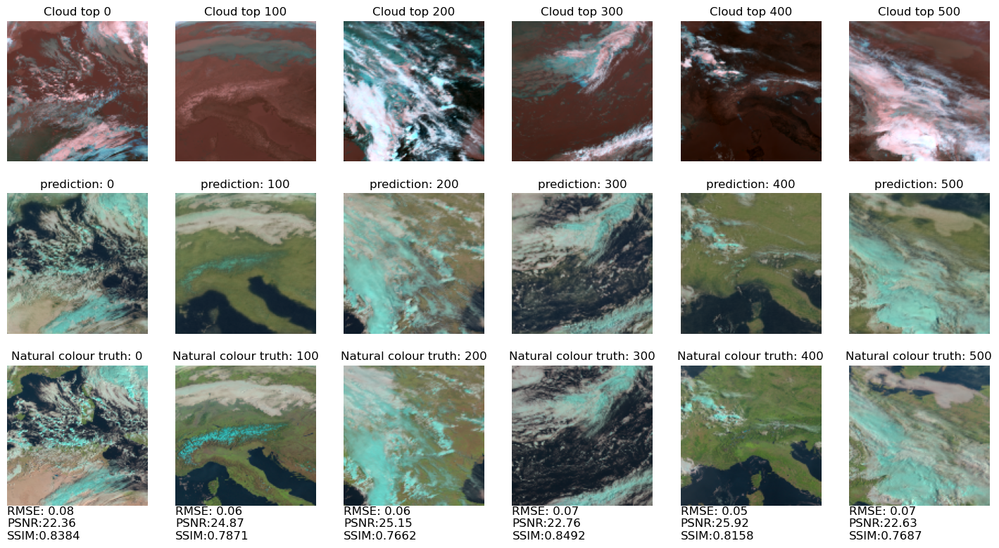

In [91]:
def unet_simple_prediction(image):
    in_img = torch.from_numpy(
        (image.transpose(2,0,1)).astype(np.float32)[np.newaxis]
    )
    out_img = unet_simple.forward(in_img)
    out_img = out_img.detach().numpy().squeeze().transpose(1,2,0)
    out_img = np.clip(out_img, 0, 1)
    return out_img

fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 100

for i in range(6):
    cloudtop_image = plt.imread(cloudtop_path/test_split.cloudtop_file[i*stride])[...,:-1]
    natural_colour_image = plt.imread(natural_colour_path/test_split.natural_colour_file[i*stride])[...,:-1]
    
    prediction_image = unet_simple_prediction(cloudtop_image)
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(prediction_image)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*stride}')

    axes[2, i].imshow(natural_colour_image)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*stride}')

    fig.text(
        *axes[2,i].get_position().bounds[0:2], 
        f'RMSE: {rmse(prediction_image, natural_colour_image):.2f}' \
        f'\nPSNR:{psnr(prediction_image, natural_colour_image):.2f}' \
        f'\nSSIM:{ssim(prediction_image, natural_colour_image):.4f}',
        ha="left", va="top", fontsize=12
    )

In [92]:
def unet_simple_multi_prediction(image):
    in_img = torch.from_numpy(
        (image.transpose(0,3,1,2)).astype(np.float32)
    )
    out_img = unet_simple.forward(in_img)
    out_img = out_img.detach().numpy().transpose(0,2,3,1)
    out_img = np.clip(out_img, 0, 1)
    return out_img

pred_img = unet_simple_multi_prediction(cloudtop_test[::10])
true_img = natural_colour_test[::10]

test_rmse = rmse(pred_img, true_img)
test_psnr = psnr(pred_img, true_img)
test_ssim = ssim(pred_img, true_img)
    
print(f'Mean RMSE: {np.mean(test_rmse)}, \nMean PSNR: {np.mean(test_psnr)}, \nMean SSIM: {np.mean(test_ssim)}')

Mean RMSE: 0.07068953041112297, 
Mean PSNR: 23.01289806674161, 
Mean SSIM: 0.9178069233894348


In [93]:
# Now reintroduce the batch norm and dropout layers

class ConvBlock(LightningModule):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.norm1 = nn.BatchNorm2d(in_ch)
        self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
        self.relu1 = nn.ReLU()
        self.norm2 = nn.BatchNorm2d(out_ch)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.relu2 = nn.ReLU()
        self.dropout = nn.Dropout2d(p=0.05) # keep 95% at each block
        
        self.block = nn.Sequential(
            self.norm1, self.conv1, self.relu1, self.norm2, self.conv2, self.relu2, self.dropout
        )
    
    def forward(self, x):
        return self.block(x)


In [94]:
_ = seed_everything(0)

unet_complex = Image2Image_UNet(
    loss_function=SSIMSquaredLoss(data_range=1), 
    learning_rate=2e-4, 
)

# Initialize the trainer
trainer = Trainer(
    max_epochs=30,
    callbacks=[LitProgressBar()],
    logger=csv_logger,
    accelerator="auto"
)

trainer.fit(unet_complex, dl)

Seed set to 0
GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs

  | Name    | Type            | Params | Mode 
----------------------------------------------------
0 | encoder | UNetEncoder     | 4.7 M  | train
1 | decoder | UNetDecoder     | 3.1 M  | train
2 | loss    | SSIMSquaredLoss | 0      | train
----------------------------------------------------
7.8 M     Trainable params
0         Non-trainable params
7.8 M     Total params
31.064    Total estimated model params size (MB)
93        Modules in train mode
0         Modules in eval mode


Epoch 29: 100%|████| 56/56 [00:21<00:00,  2.55it/s, v_num=0, train_loss_step=0.392, val_loss_step=0.389, val_loss_epoch=0.356, train_loss_epoch=0.366]

`Trainer.fit` stopped: `max_epochs=30` reached.


Epoch 29: 100%|████| 56/56 [00:22<00:00,  2.54it/s, v_num=0, train_loss_step=0.392, val_loss_step=0.389, val_loss_epoch=0.356, train_loss_epoch=0.366]


In [95]:
# compute validation metrics on the best model
trainer.validate(unet_complex, dl.val_dataloader())
_ = unet_complex.eval()

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
     Validate metric           DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
     val_loss_epoch         0.3556811213493347
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


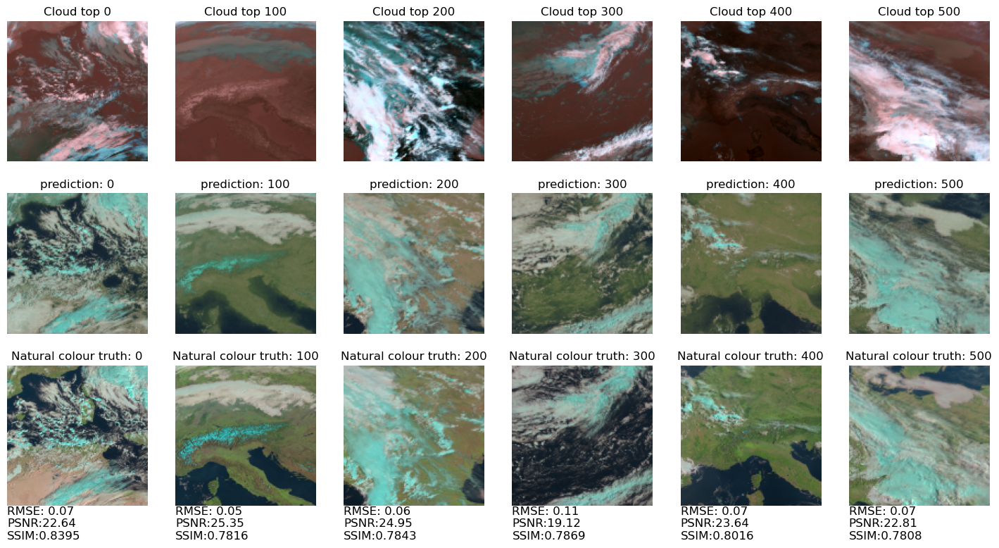

In [96]:
def unet_complex_prediction(image):
    in_img = torch.from_numpy(
        (image.transpose(2,0,1)).astype(np.float32)[np.newaxis]
    )
    out_img = unet_complex.forward(in_img)
    out_img = out_img.detach().numpy().squeeze().transpose(1,2,0)
    out_img = np.clip(out_img, 0, 1)
    return out_img

fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 100

for i in range(6):
    cloudtop_image = plt.imread(cloudtop_path/test_split.cloudtop_file[i*stride])[...,:-1]
    natural_colour_image = plt.imread(natural_colour_path/test_split.natural_colour_file[i*stride])[...,:-1]
    
    prediction_image = unet_complex_prediction(cloudtop_image)
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(prediction_image)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*stride}')

    axes[2, i].imshow(natural_colour_image)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*stride}')

    fig.text(
        *axes[2,i].get_position().bounds[0:2], 
        f'RMSE: {rmse(prediction_image, natural_colour_image):.2f}' \
        f'\nPSNR:{psnr(prediction_image, natural_colour_image):.2f}' \
        f'\nSSIM:{ssim(prediction_image, natural_colour_image):.4f}',
        ha="left", va="top", fontsize=12
    )

In [97]:
def unet_complex_multi_prediction(image):
    in_img = torch.from_numpy(
        (image.transpose(0,3,1,2)).astype(np.float32)
    )
    out_img = unet_complex.forward(in_img)
    out_img = out_img.detach().numpy().transpose(0,2,3,1)
    out_img = np.clip(out_img, 0, 1)
    return out_img

pred_img = unet_complex_multi_prediction(cloudtop_test[::10])
true_img = natural_colour_test[::10]

test_rmse = rmse(pred_img, true_img)
test_psnr = psnr(pred_img, true_img)
test_ssim = ssim(pred_img, true_img)
    
print(f'Mean RMSE: {np.mean(test_rmse)}, \nMean PSNR: {np.mean(test_psnr)}, \nMean SSIM: {np.mean(test_ssim)}')

Mean RMSE: 0.07479380593040216, 
Mean PSNR: 22.522687337264898, 
Mean SSIM: 0.9055691361427307


Both models provide very similar results, with a marginal difference in metrics. Complex models tend to be more useful when a simple model is reaching a plateau of skill

### Extension exercises

#### 5: ResUNet

ResUNets use combine residual neural nets, which help to stabilise the convergence of deep neural networks. A residual network is composed of units of the form x -> f(x) + x, which we use here in place of the convolution blocks in the UNet 

In [98]:
# Define a residual block module to use in place of the convolution block:

class ResBlock(LightningModule):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.norm1 = nn.BatchNorm2d(in_ch)
        self.relu1 = nn.ReLU()
        self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
        self.norm2 = nn.BatchNorm2d(out_ch)
        self.relu2 = nn.ReLU()
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        
        self.dropout = nn.Dropout2d(p=0.05) # keep 95% at each block

        # Note that the order of the layers is changed
        self.block = nn.Sequential(
            self.norm1, self.relu1, self.conv1, self.norm2, self.relu2, self.conv2, 
        )

        self.identity = nn.Conv2d(in_ch, out_ch, 1)
    
    def forward(self, x):
        return self.dropout(self.identity(x) + self.block(x))

# We also need to define a new input block:

class InputBlock(LightningModule):
    def __init__(self, in_ch, out_ch):
        super().__init__()
        self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
        self.norm1 = nn.BatchNorm2d(out_ch)
        self.relu1 = nn.ReLU()
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        
        self.dropout = nn.Dropout2d(p=0.05) # keep 95% at each block

        # Note that the order of the layers is changed
        self.block = nn.Sequential(
            self.conv1, self.norm1, self.relu1, self.conv2, 
        )

        self.identity = nn.Conv2d(in_ch, out_ch, 1)
    
    def forward(self, x):
        return self.dropout(self.identity(x) + self.block(x))


In [99]:
# And now a new encoder and decoder which can use these:
class ResUNetEncoder(LightningModule):
    def __init__(self, input_channels: int = 3, initial_layer_channels: int = 32, depth: int = 4):
        super().__init__()
        self.channels = [initial_layer_channels*2**i for i in range(depth+1)]
        
        self.input_block = InputBlock(input_channels, initial_layer_channels)
        
        self.encode_blocks = nn.ModuleList(
            [ResBlock(self.channels[i], self.channels[i+1]) for i in range(depth)]
        )
        self.pool = nn.MaxPool2d(2)
    
    def forward(self, x):
        features = []
        
        x = self.input_block(x)
        features.append(x)
        
        for block in self.encode_blocks:
            x = self.pool(x)
            x = block(x)
            features.append(x)
        return features[::-1]

class ResUNetDecoder(LightningModule):
    def __init__(self, output_channels=3, initial_layer_channels: int = 32, depth: int = 4):
        super().__init__()
        self.channels = [initial_layer_channels*2**i for i in range(depth+1)][::-1]
        self.upconvs = nn.ModuleList([
            nn.ConvTranspose2d(self.channels[i], self.channels[i+1], 2, 2) for i in range(len(self.channels)-1)
        ])
        self.decode_blocks = nn.ModuleList(
            [ResBlock(self.channels[i], self.channels[i+1]) for i in range(len(self.channels)-1)]
        )
        self.head = nn.Sequential(
            nn.Conv2d(initial_layer_channels, output_channels, 1), 
            nn.Sigmoid()
        )
        
    def forward(self, x, features):
        for upconv, block, feature in zip(self.upconvs, self.decode_blocks, features):
            x = upconv(x)
            x = torch.cat([x, feature], dim=-3)
            x = block(x)
        return torch.clamp(self.head(x), min=0, max=1)


In [100]:
class Image2Image_ResUNet(LightningModule):
    def __init__(
        self, 
        input_channels: int = 3, 
        output_channels: int = 3, 
        initial_layer_channels: int = 32, 
        depth: int = 4, 
        learning_rate: float = 1.5e-4,
        loss_function = nn.MSELoss()
    ):
        super().__init__()
        
        # Define encoder and decoder
        self.encoder = ResUNetEncoder(
            input_channels=input_channels, initial_layer_channels=initial_layer_channels, depth=depth
        )
        self.decoder = ResUNetDecoder(
            initial_layer_channels=initial_layer_channels, depth=depth
        )
        
        # define & log hyperparameters
        self.learning_rate = learning_rate
        self.save_hyperparameters(ignore=['loss_function'])

        # loss function
        self.loss = loss_function

    def forward(self, x):
        features = self.encoder(x)
        x = self.decoder(features[0], features[1:])
        return x

    def compute_loss(self, batch):
        image, target = batch
        # forward pass
        predictions = self(image).squeeze()
        # calculate loss
        loss = self.loss(predictions, target)
        return loss

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=self.learning_rate)

        return {
            "optimizer": optimizer,
            "lr_scheduler": {
                "scheduler": ReduceLROnPlateau(optimizer),
                "patience": 10,
                "interval": "epoch",
                "monitor": "val_loss",
                "frequency": 1,
            },
        }

    def training_step(self, batch, batch_idx):
        loss = self.compute_loss(batch)
        # log training loss
        self.log(
            "train_loss", loss, on_step=True, on_epoch=True, logger=True, prog_bar=True
        )
        return loss
    
    def validation_step(self, batch, batch_idx):
        loss = self.compute_loss(batch)
        # log validation loss
        self.log(
            "val_loss", loss, on_step=True, on_epoch=True, logger=True, prog_bar=True
        )
        return loss

    def test_step(self, batch, batch_idx):
        loss = self.compute_loss(batch)
        # log test loss
        self.log(
            "test_loss", loss, on_step=True, on_epoch=True, logger=True, prog_bar=True
        )
        return loss

In [101]:
_ = seed_everything(0)

resunet = Image2Image_ResUNet(
    loss_function=SSIMSquaredLoss(data_range=1), 
    learning_rate=2e-4, 
)

# Initialize the trainer
trainer = Trainer(
    max_epochs=10,
    callbacks=[LitProgressBar()],
    logger=csv_logger,
    accelerator="auto"
)

trainer.fit(resunet, dl)

Seed set to 0
GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs

  | Name    | Type            | Params | Mode 
----------------------------------------------------
0 | encoder | ResUNetEncoder  | 4.9 M  | train
1 | decoder | ResUNetDecoder  | 3.2 M  | train
2 | loss    | SSIMSquaredLoss | 0      | train
----------------------------------------------------
8.1 M     Trainable params
0         Non-trainable params
8.1 M     Total params
32.463    Total estimated model params size (MB)
102       Modules in train mode
0         Modules in eval mode


Epoch 9: 100%|█████| 56/56 [00:24<00:00,  2.32it/s, v_num=0, train_loss_step=0.404, val_loss_step=0.417, val_loss_epoch=0.388, train_loss_epoch=0.403]

`Trainer.fit` stopped: `max_epochs=10` reached.


Epoch 9: 100%|█████| 56/56 [00:24<00:00,  2.30it/s, v_num=0, train_loss_step=0.404, val_loss_step=0.417, val_loss_epoch=0.388, train_loss_epoch=0.403]


In [102]:
# compute validation metrics on the best model
trainer.validate(resunet, dl.val_dataloader())
_ = resunet.eval()

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
     Validate metric           DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
     val_loss_epoch         0.38757815957069397
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


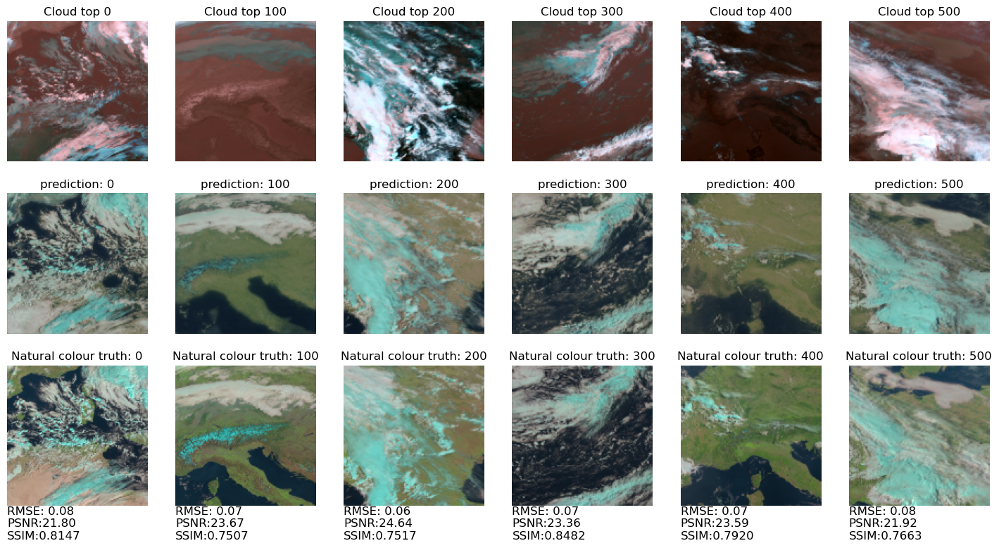

In [103]:
def resunet_prediction(image):
    in_img = torch.from_numpy(
        (image.transpose(2,0,1)).astype(np.float32)[np.newaxis]
    )
    out_img = resunet.forward(in_img)
    out_img = out_img.detach().numpy().squeeze().transpose(1,2,0)
    out_img = np.clip(out_img, 0, 1)
    return out_img

fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 100

for i in range(6):
    cloudtop_image = plt.imread(cloudtop_path/test_split.cloudtop_file[i*stride])[...,:-1]
    natural_colour_image = plt.imread(natural_colour_path/test_split.natural_colour_file[i*stride])[...,:-1]
    
    prediction_image = resunet_prediction(cloudtop_image)
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(prediction_image)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*stride}')

    axes[2, i].imshow(natural_colour_image)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*stride}')

    fig.text(
        *axes[2,i].get_position().bounds[0:2], 
        f'RMSE: {rmse(prediction_image, natural_colour_image):.2f}' \
        f'\nPSNR:{psnr(prediction_image, natural_colour_image):.2f}' \
        f'\nSSIM:{ssim(prediction_image, natural_colour_image):.4f}',
        ha="left", va="top", fontsize=12
    )

In [104]:
def resunet_multi_prediction(image):
    in_img = torch.from_numpy(
        (image.transpose(0,3,1,2)).astype(np.float32)
    )
    out_img = resunet.forward(in_img)
    out_img = out_img.detach().numpy().transpose(0,2,3,1)
    out_img = np.clip(out_img, 0, 1)
    return out_img

pred_img = resunet_multi_prediction(cloudtop_test[::10])
true_img = natural_colour_test[::10]

test_rmse = rmse(pred_img, true_img)
test_psnr = psnr(pred_img, true_img)
test_ssim = ssim(pred_img, true_img)
    
print(f'Mean RMSE: {np.mean(test_rmse)}, \nMean PSNR: {np.mean(test_psnr)}, \nMean SSIM: {np.mean(test_ssim)}')

Mean RMSE: 0.07652079099763412, 
Mean PSNR: 22.324410986137867, 
Mean SSIM: 0.9062051773071289


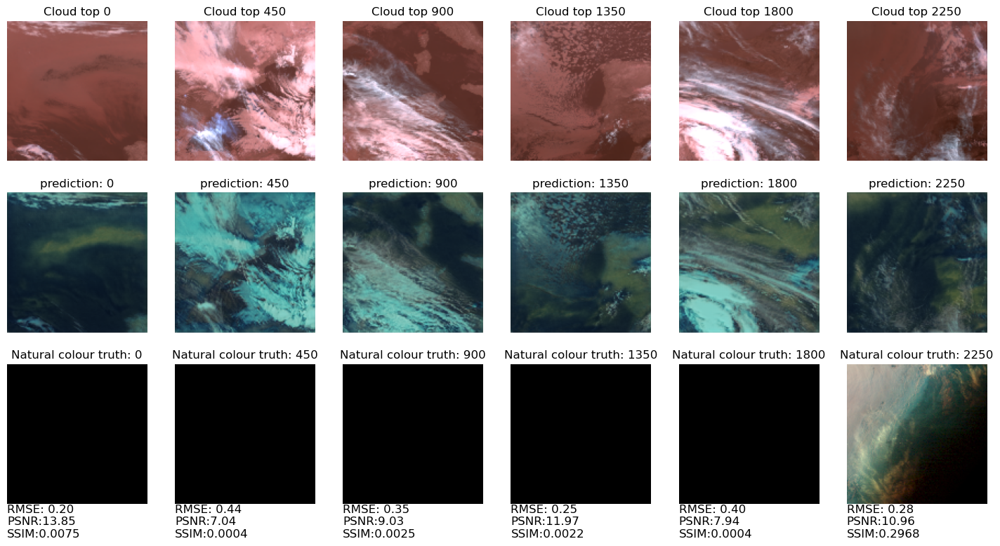

In [105]:
fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 450

for i in range(6):
    natural_colour_image = plt.imread(natural_colour_path/splits_night.natural_colour_file[i*stride])[...,:-1]
    cloudtop_image = plt.imread(cloudtop_path/splits_night.cloudtop_file[i*stride])[...,:-1]
    
    pred_img = resunet_prediction(cloudtop_image)
    true_img = natural_colour_image
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(pred_img)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*stride}')

    axes[2, i].imshow(true_img)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*stride}')

    fig.text(
        *axes[2,i].get_position().bounds[0:2], 
        f'RMSE: {rmse(pred_img, true_img):.2f}' \
        f'\nPSNR:{psnr(pred_img, true_img):.2f}' \
        f'\nSSIM:{ssim(pred_img, true_img):.4f}',
        ha="left", va="top", fontsize=12
    )

The ResUNet provides similar skill to our longer UNet training runs before with only 10 epochs of training. It also produces better predictions with actual night time input, with less of a blue tint. The results are still slightly blobby, which leads to the next exercise...

#### 6: UNet++

An issue with the UNet is that at lower depths (higher spatial resolution) the model has fewer layers, so that less complex relationship can be learned. The UNet++ model addresses this by nesting multiple decoders, one at each depth. The UNet++ also allows deep supervision, which we will implement to help better guide the model training along with an adapted loss function. We will actually implement it with residual blocks here, as the performance was so much better than for the standard UNet

In [ ]:
# The encoder is the same as the ResUNet, the decoder however needs modifying to accept features with different lengths, 
#  and to return features at every depth

class ResUNetPlusPlusDecoder(LightningModule):
    def __init__(self, output_channels=3, initial_layer_channels: int = 32, depth: int = 4):
        super().__init__()
        self.channels = [initial_layer_channels*2**i for i in range(depth+1)][::-1]
        self.upconvs = nn.ModuleList([
            nn.ConvTranspose2d(self.channels[i], self.channels[i+1], 2, 2) for i in range(depth)
        ])
        self.decode_blocks = nn.ModuleList(
            [ResBlock(self.channels[i] + i*self.channels[i+1], self.channels[i+1]) for i in range(depth)]
        )
        
    def forward(self, x, features):
        output_features = []
        for upconv, block, feature in zip(self.upconvs, self.decode_blocks, features):
            x = upconv(x)
            x = torch.cat([x, feature], dim=-3)
            x = block(x)
            output_features.append(x)
        return output_features


In [232]:
# New decoder level approach should be a bit nicer

# This way we slice the nested decoder for all steps at the same depth

class ResUNetPlusPlusDecoderLevel(LightningModule):
    def __init__(self, out_channels, blocks):
        super().__init__()
        self.upconv = nn.ConvTranspose2d(out_channels * 2, out_channels, 2, 2)
        self.decode_blocks = nn.ModuleList(
            [ResBlock(out_channels * i, out_channels) for i in range(2, blocks+2)]
        )

    def forward(self, input_features, decode_features):
        output_features = []
        if isinstance(decode_features, list):
            for i, (block, decoder_feature) in enumerate(
                zip(self.decode_blocks, decode_features)
            ):
                output_features.append(
                    block(torch.cat([self.upconv(decoder_feature), input_features]+output_features, dim=-3))
                )
        else:
            output_features.append(
                self.decode_blocks[0](torch.cat([self.upconv(decode_features), input_features], dim=-3))
            )
        return output_features


class ResUNetPlusPlusDecoder(LightningModule):
    def __init__(self, initial_layer_channels: int = 32, depth: int = 4):
        super().__init__()
        self.channels = [initial_layer_channels*2**i for i in range(depth)][::-1]
        self.decode_levels = nn.ModuleList(
            [ResUNetPlusPlusDecoderLevel(channels, i) for i, channels in enumerate(self.channels, start=1)]
        )
        
    def forward(self, encoder_features):
        output_features = []
        for i, level in enumerate(self.decode_levels):
            output_features = level(encoder_features[i+1], encoder_features[i:i+1] + output_features)
        return output_features


In [233]:
# Now we need a deep supervision loss module that can take output from multiple layers of the model:

class DeepSupervisionLoss(LightningModule):
    def __init__(self, loss_function):
        super().__init__()
        self.loss = loss_function

    def forward(self, x_list, y):
        if isinstance(x_list, list):
            weights = 2.**(np.arange(-len(x_list), 0))
    
            return sum(
                [weight*self.loss(x, y) for weight, x in zip(weights, x_list)]
            )

        return self.loss(x_list, y)

In [253]:
# And now the new model:

class Image2Image_ResUNetPlusPlus(LightningModule):
    def __init__(
        self, 
        input_channels: int = 3, 
        output_channels: int = 3, 
        initial_layer_channels: int = 32, 
        depth: int = 4, 
        learning_rate: float = 1.5e-4,
        loss_function = nn.MSELoss()
    ):
        super().__init__()
        
        # Define encoder and decoder
        self.encoder = ResUNetEncoder(
            input_channels=input_channels, initial_layer_channels=initial_layer_channels, depth=depth
        )
        self.decoder = ResUNetPlusPlusDecoder(
            initial_layer_channels=initial_layer_channels, depth=depth
        )

        # Head layers
        self.heads = nn.ModuleList(
            [nn.Sequential(
                nn.Conv2d(initial_layer_channels, output_channels, 1), 
                nn.Sigmoid()
            )
            for _ in range(depth)]
        )
        
        # define & log hyperparameters
        self.learning_rate = learning_rate
        self.save_hyperparameters(ignore=['loss_function'])

        # loss function
        self.loss = DeepSupervisionLoss(loss_function)
        self.depth = depth

    def forward(self, x):
        encoder_features = self.encoder(x)
        decoder_features = self.decoder(encoder_features)

        # If training, return all output features
        if self.training:
            return [
                torch.clamp(head(features), 0, 1) for head, features in zip(
                    self.heads, decoder_features
                )
            ]
        
        # Else return just the final features
        return torch.clamp(self.heads[-1](decoder_features[-1]), 0, 1)

    def compute_loss(self, batch):
        image, target = batch
        # forward pass
        predictions = self(image)
        # calculate loss
        loss = self.loss(predictions, target)
        return loss

    def configure_optimizers(self):
        optimizer = torch.optim.Adam(self.parameters(), lr=self.learning_rate)

        return {
            "optimizer": optimizer,
            "lr_scheduler": {
                "scheduler": ReduceLROnPlateau(optimizer),
                "patience": 10,
                "interval": "epoch",
                "monitor": "val_loss",
                "frequency": 1,
            },
        }

    def training_step(self, batch, batch_idx):
        loss = self.compute_loss(batch)
        # log training loss
        self.log(
            "train_loss", loss, on_step=True, on_epoch=True, logger=True, prog_bar=True
        )
        return loss
    
    def validation_step(self, batch, batch_idx):
        loss = self.compute_loss(batch)
        # log validation loss
        self.log(
            "val_loss", loss, on_step=True, on_epoch=True, logger=True, prog_bar=True
        )
        return loss

    def test_step(self, batch, batch_idx):
        loss = self.compute_loss(batch)
        # log test loss
        self.log(
            "test_loss", loss, on_step=True, on_epoch=True, logger=True, prog_bar=True
        )
        return loss

In [254]:
_ = seed_everything(0)

resunetpp = Image2Image_ResUNetPlusPlus(
    loss_function=SSIMSquaredLoss(data_range=1), 
    learning_rate=2e-4, 
)

# Initialize the trainer
trainer = Trainer(
    max_epochs=10,
    callbacks=[LitProgressBar()],
    logger=csv_logger,
    accelerator="auto"
)

trainer.fit(resunetpp, dl)

Seed set to 0
GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs

  | Name    | Type                   | Params | Mode 
-----------------------------------------------------------
0 | encoder | ResUNetEncoder         | 4.9 M  | train
1 | decoder | ResUNetPlusPlusDecoder | 4.4 M  | train
2 | heads   | ModuleList             | 396    | train
3 | loss    | DeepSupervisionLoss    | 0      | train
-----------------------------------------------------------
9.3 M     Trainable params
0         Non-trainable params
9.3 M     Total params
37.081    Total estimated model params size (MB)
180       Modules in train mode
0         Modules in eval mode


/Users/jonesw/miniforge3/envs/iecdt-earth-obs/lib/python3.13/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=10` in the `DataLoader` to improve performance.


Epoch 9: 100%|█████| 56/56 [00:55<00:00,  1.01it/s, v_num=0, train_loss_step=0.351, val_loss_step=0.407, val_loss_epoch=0.371, train_loss_epoch=0.377]

`Trainer.fit` stopped: `max_epochs=10` reached.


Epoch 9: 100%|█████| 56/56 [00:55<00:00,  1.01it/s, v_num=0, train_loss_step=0.351, val_loss_step=0.407, val_loss_epoch=0.371, train_loss_epoch=0.377]


In [255]:
# compute validation metrics on the best model
trainer.validate(resunetpp, dl.val_dataloader())
_ = resunetpp.eval()

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
     Validate metric           DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
     val_loss_epoch         0.37080690264701843
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


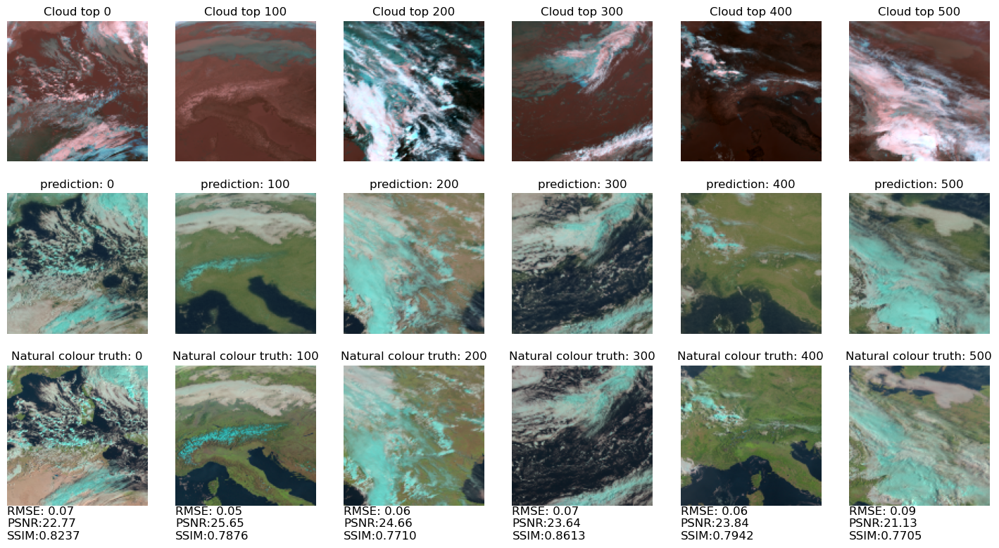

In [256]:
def resunetpp_prediction(image):
    in_img = torch.from_numpy(
        (image.transpose(2,0,1)).astype(np.float32)[np.newaxis]
    )
    out_img = resunetpp.forward(in_img)
    out_img = out_img.detach().numpy().squeeze().transpose(1,2,0)
    out_img = np.clip(out_img, 0, 1)
    return out_img

fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 100

for i in range(6):
    cloudtop_image = plt.imread(cloudtop_path/test_split.cloudtop_file[i*stride])[...,:-1]
    natural_colour_image = plt.imread(natural_colour_path/test_split.natural_colour_file[i*stride])[...,:-1]
    
    prediction_image = resunetpp_prediction(cloudtop_image)
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(prediction_image)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*stride}')

    axes[2, i].imshow(natural_colour_image)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*stride}')

    fig.text(
        *axes[2,i].get_position().bounds[0:2], 
        f'RMSE: {rmse(prediction_image, natural_colour_image):.2f}' \
        f'\nPSNR:{psnr(prediction_image, natural_colour_image):.2f}' \
        f'\nSSIM:{ssim(prediction_image, natural_colour_image):.4f}',
        ha="left", va="top", fontsize=12
    )

In [257]:
def resunetpp_multi_prediction(image):
    in_img = torch.from_numpy(
        (image.transpose(0,3,1,2)).astype(np.float32)
    )
    out_img = resunetpp.forward(in_img)
    out_img = out_img.detach().numpy().transpose(0,2,3,1)
    out_img = np.clip(out_img, 0, 1)
    return out_img

pred_img = resunetpp_multi_prediction(cloudtop_test[::10])
true_img = natural_colour_test[::10]

test_rmse = rmse(pred_img, true_img)
test_psnr = psnr(pred_img, true_img)
test_ssim = ssim(pred_img, true_img)
    
print(f'Mean RMSE: {np.mean(test_rmse)}, \nMean PSNR: {np.mean(test_psnr)}, \nMean SSIM: {np.mean(test_ssim)}')

Mean RMSE: 0.07348038072481637, 
Mean PSNR: 22.676572042899295, 
Mean SSIM: 0.9115476608276367


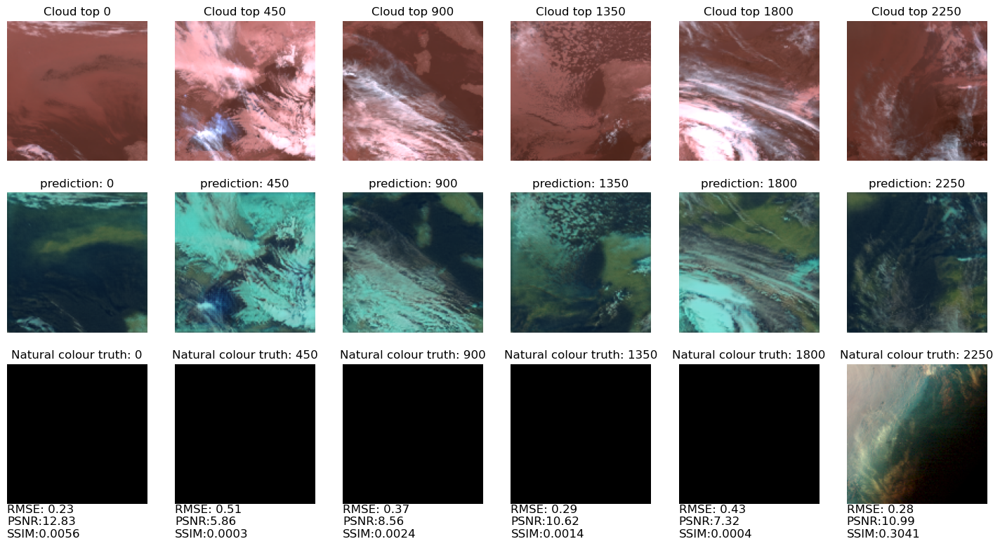

In [258]:
fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 450

for i in range(6):
    natural_colour_image = plt.imread(natural_colour_path/splits_night.natural_colour_file[i*stride])[...,:-1]
    cloudtop_image = plt.imread(cloudtop_path/splits_night.cloudtop_file[i*stride])[...,:-1]
    
    pred_img = resunetpp_prediction(cloudtop_image)
    true_img = natural_colour_image
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(pred_img)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*stride}')

    axes[2, i].imshow(true_img)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*stride}')

    fig.text(
        *axes[2,i].get_position().bounds[0:2], 
        f'RMSE: {rmse(pred_img, true_img):.2f}' \
        f'\nPSNR:{psnr(pred_img, true_img):.2f}' \
        f'\nSSIM:{ssim(pred_img, true_img):.4f}',
        ha="left", va="top", fontsize=12
    )

While the results have improved, the change is not much. It is likely that we are pushing the the limits of this dataset and the UNet structure. Furthermore, the model took a lot longer to train, due to the increased number of paramaters. The UNet 3+ model was developed as a response to this, providing improved skill with similar number of parameters to the original UNet.

As the ResUNet was more performant, let's try training that for longer:

In [259]:
_ = seed_everything(0)

resunet = Image2Image_ResUNet(
    loss_function=SSIMSquaredLoss(data_range=1), 
    learning_rate=2e-4, 
)

# Initialize the trainer
trainer = Trainer(
    max_epochs=30,
    callbacks=[LitProgressBar()],
    logger=csv_logger,
    accelerator="auto"
)

trainer.fit(resunet, dl)

Seed set to 0
GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs

  | Name    | Type            | Params | Mode 
----------------------------------------------------
0 | encoder | ResUNetEncoder  | 4.9 M  | train
1 | decoder | ResUNetDecoder  | 3.2 M  | train
2 | loss    | SSIMSquaredLoss | 0      | train
----------------------------------------------------
8.1 M     Trainable params
0         Non-trainable params
8.1 M     Total params
32.463    Total estimated model params size (MB)
102       Modules in train mode
0         Modules in eval mode


Epoch 29: 100%|████| 56/56 [00:24<00:00,  2.26it/s, v_num=0, train_loss_step=0.348, val_loss_step=0.376, val_loss_epoch=0.319, train_loss_epoch=0.325]

`Trainer.fit` stopped: `max_epochs=30` reached.


Epoch 29: 100%|████| 56/56 [00:24<00:00,  2.25it/s, v_num=0, train_loss_step=0.348, val_loss_step=0.376, val_loss_epoch=0.319, train_loss_epoch=0.325]


In [260]:
# compute validation metrics on the best model
trainer.validate(resunet, dl.val_dataloader())
_ = resunet.eval()

────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
     Validate metric           DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
     val_loss_epoch         0.3192037343978882
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


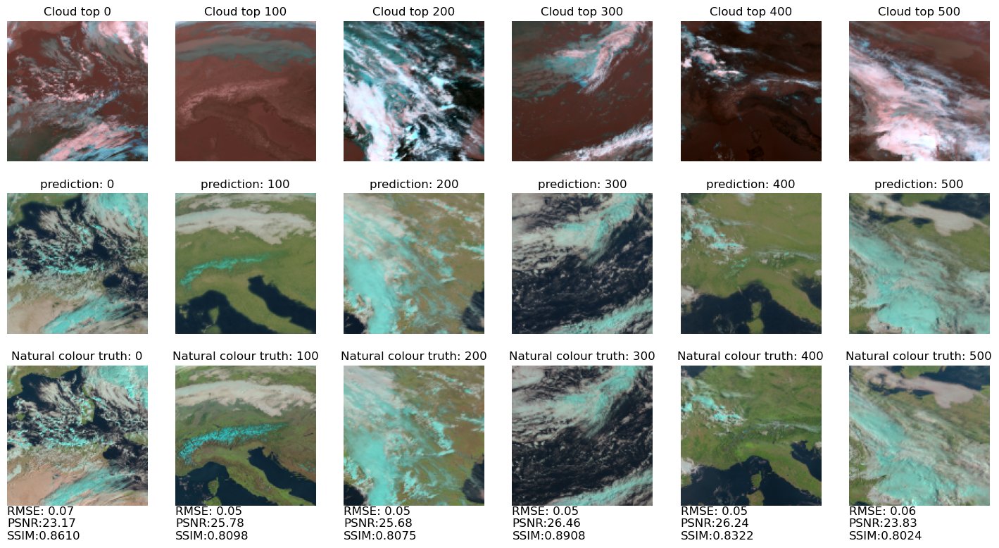

In [261]:
def resunet_prediction(image):
    in_img = torch.from_numpy(
        (image.transpose(2,0,1)).astype(np.float32)[np.newaxis]
    )
    out_img = resunet.forward(in_img)
    out_img = out_img.detach().numpy().squeeze().transpose(1,2,0)
    out_img = np.clip(out_img, 0, 1)
    return out_img

fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 100

for i in range(6):
    cloudtop_image = plt.imread(cloudtop_path/test_split.cloudtop_file[i*stride])[...,:-1]
    natural_colour_image = plt.imread(natural_colour_path/test_split.natural_colour_file[i*stride])[...,:-1]
    
    prediction_image = resunet_prediction(cloudtop_image)
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(prediction_image)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*stride}')

    axes[2, i].imshow(natural_colour_image)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*stride}')

    fig.text(
        *axes[2,i].get_position().bounds[0:2], 
        f'RMSE: {rmse(prediction_image, natural_colour_image):.2f}' \
        f'\nPSNR:{psnr(prediction_image, natural_colour_image):.2f}' \
        f'\nSSIM:{ssim(prediction_image, natural_colour_image):.4f}',
        ha="left", va="top", fontsize=12
    )

In [262]:
def resunet_multi_prediction(image):
    in_img = torch.from_numpy(
        (image.transpose(0,3,1,2)).astype(np.float32)
    )
    out_img = resunet.forward(in_img)
    out_img = out_img.detach().numpy().transpose(0,2,3,1)
    out_img = np.clip(out_img, 0, 1)
    return out_img

pred_img = resunet_multi_prediction(cloudtop_test[::10])
true_img = natural_colour_test[::10]

test_rmse = rmse(pred_img, true_img)
test_psnr = psnr(pred_img, true_img)
test_ssim = ssim(pred_img, true_img)
    
print(f'Mean RMSE: {np.mean(test_rmse)}, \nMean PSNR: {np.mean(test_psnr)}, \nMean SSIM: {np.mean(test_ssim)}')

Mean RMSE: 0.06262755563651587, 
Mean PSNR: 24.064690771015947, 
Mean SSIM: 0.93878173828125


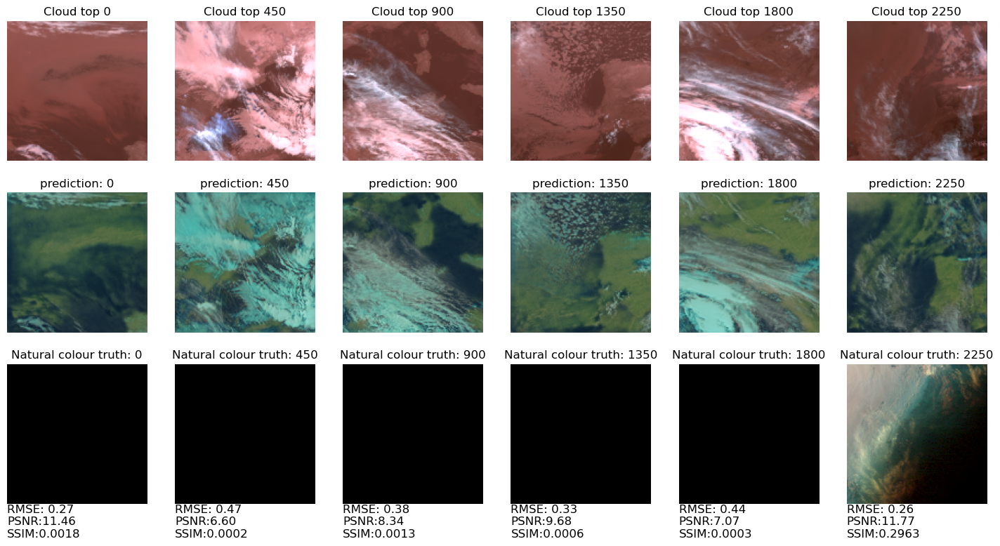

In [263]:
fig, axes = plt.subplots(3, 6, figsize=(18,9))

stride = 450

for i in range(6):
    natural_colour_image = plt.imread(natural_colour_path/splits_night.natural_colour_file[i*stride])[...,:-1]
    cloudtop_image = plt.imread(cloudtop_path/splits_night.cloudtop_file[i*stride])[...,:-1]
    
    pred_img = resunet_prediction(cloudtop_image)
    true_img = natural_colour_image
    
    axes[0, i].imshow(cloudtop_image)
    axes[0, i].set_axis_off()
    axes[0, i].set_title(f'Cloud top {i*stride}')
    
    axes[1, i].imshow(pred_img)
    axes[1, i].set_axis_off()
    axes[1, i].set_title(f'prediction: {i*stride}')

    axes[2, i].imshow(true_img)
    axes[2, i].set_axis_off()
    axes[2, i].set_title(f'Natural colour truth: {i*stride}')

    fig.text(
        *axes[2,i].get_position().bounds[0:2], 
        f'RMSE: {rmse(pred_img, true_img):.2f}' \
        f'\nPSNR:{psnr(pred_img, true_img):.2f}' \
        f'\nSSIM:{ssim(pred_img, true_img):.4f}',
        ha="left", va="top", fontsize=12
    )

#### 7: Alternative models

A generative model archetecture, such as a GAN or diffusion model may be able to produce more realistic imagery at night.

A PatchGAN model was previously used for this challenge during the CI2020 hackathon, as was able to produce better looking results at night, although it did not score as well as UNet based solutions for daytime imagery. If you would like to look into this more, see the following:

[PatchGAN notebook](https://github.com/shahineb/ci-hackathon/blob/646c0c2a9b504639c78168654bff388f0e207f87/notebooks/demo.ipynb)
[PatchGAN model](https://github.com/shahineb/ci-hackathon/blob/646c0c2a9b504639c78168654bff388f0e207f87/src/models/patchgan.py)